# Endometriosis - Clustering
# Epithelial Cells - all datasets

In [1]:
import numpy as np
import pandas as pd
import scanpy as sc
import anndata
import os
import sys

def MovePlots(plotpattern, subplotdir):
    os.system('mkdir -p '+str(sc.settings.figdir)+'/'+subplotdir)
    os.system('mv '+str(sc.settings.figdir)+'/*'+plotpattern+'** '+str(sc.settings.figdir)+'/'+subplotdir)

sc.settings.verbosity = 3  # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.settings.figdir = './figures/cells/epithelial_dirty/'
sc.settings.set_figure_params(dpi=80)  # low dpi (dots per inch) yields small inline figures

sys.executable

'/home/jovyan/my-conda-envs/sc_analysis/bin/python'

## Load data

In [2]:
path2datas = '/nfs/team292/lg18/endometriosis/integrated_objects/'
adata = sc.read(path2datas+'cells_epithelial_integrated.h5ad')
adata.X.shape

(112973, 17736)

## Add sample metadata

In [3]:
meta_sample = pd.read_csv('metadata-libraries_deconvoluted.csv',index_col=1)
meta_sample


annot = meta_sample['Biopsy_type'].to_dict()
adata.obs['Biopsy_type'] = adata.obs.Library_genotype.map(annot)
print(adata.obs['Biopsy_type'].value_counts())

annot = meta_sample['Tissue_sampled'].to_dict()
adata.obs['Tissue_sampled'] = adata.obs.Library_genotype.map(annot)
print(adata.obs['Tissue_sampled'].value_counts())

annot = meta_sample['Group'].to_dict()
adata.obs['Group'] = adata.obs.Library_genotype.map(annot)
print(adata.obs['Group'].value_counts())

annot = meta_sample['Spatial_location'].to_dict()
adata.obs['Spatial_location'] = adata.obs.Library_genotype.map(annot)
print(adata.obs['Spatial_location'].value_counts())

annot = meta_sample['Ectopic_group'].to_dict()
adata.obs['Ectopic_group'] = adata.obs.Library_genotype.map(annot)
print(adata.obs['Ectopic_group'].value_counts())

annot = meta_sample['BiopsyType_old'].to_dict()
adata.obs['BiopsyType_old'] = adata.obs.Library_genotype.map(annot)
print(adata.obs['BiopsyType_old'].value_counts())

annot = meta_sample['Tissue'].to_dict()
adata.obs['Tissue'] = adata.obs.Library_genotype.map(annot)
print(adata.obs['Tissue'].value_counts())

annot = meta_sample['Treatment'].to_dict()
adata.obs['Treatment'] = adata.obs.Library_genotype.map(annot)
print(adata.obs['Treatment'].value_counts())

annot = meta_sample['10x kit'].to_dict()
adata.obs['10x kit'] = adata.obs.Library_genotype.map(annot)
print(adata.obs['10x kit'].value_counts())


annot = meta_sample['Processing'].to_dict()
adata.obs['Processing'] = adata.obs.Library_genotype.map(annot)
print(adata.obs['Processing'].value_counts())

Superficial_Eutopic    109947
Whole_Uterus             3026
Name: Biopsy_type, dtype: int64
eutopic_endometrium    112973
Name: Tissue_sampled, dtype: int64
Ctrl_Superficial     70097
Endo_Superficial     39850
Ctrl_whole_uterus     3026
Name: Group, dtype: int64
Series([], Name: Spatial_location, dtype: int64)
Series([], Name: Ectopic_group, dtype: int64)
Superficial            109879
Organ_Donor              3026
Control_Endometrium        68
Name: BiopsyType_old, dtype: int64
None         93444
EN_enrich     3026
EN            1089
Name: Tissue, dtype: int64
Coll.+Trypsin       46811
Collagenase         26639
Trypsin             22952
ColdDig_LiveSort    15414
Unknown                68
Name: Treatment, dtype: int64
3' v3.1    68953
3' v3.2    23171
3' v3      15414
3' v3.0     4278
3'          1089
Name: 10x kit, dtype: int64
Fresh     90398
Frozen    22575
Name: Processing, dtype: int64


## Add donor metadata

In [4]:
meta_donors = pd.read_csv('metadata-donors.csv',index_col=None)
meta_donors = meta_donors.set_index('Donor')
meta_donors

annot = meta_donors['Endometrial pathology_A-F-H-P'].to_dict()
adata.obs['Endometrial_pathology'] = adata.obs.genotype.map(annot)
set(adata.obs['Endometrial_pathology'])

annot = meta_donors['Endometriosis_stage'].to_dict()
adata.obs['Endometriosis_stage'] = adata.obs.genotype.map(annot)
set(adata.obs['Endometriosis_stage'])

annot = meta_donors['Ectopic_EcP_EcO_EcPA_EcP-D'].to_dict()
adata.obs['Ectopic_EcP_EcO_EcPA_EcP-D'] = adata.obs.genotype.map(annot)
set(adata.obs['Ectopic_EcP_EcO_EcPA_EcP-D'])

annot = meta_donors['Peritoneal_Ovarian_DIE'].to_dict()
adata.obs['Peritoneal_Ovarian_DIE'] = adata.obs.genotype.map(annot)
set(adata.obs['Peritoneal_Ovarian_DIE'])

annot = meta_donors['Hormonal treatment'].to_dict()
adata.obs['Hormonal treatment'] = adata.obs.genotype.map(annot)
set(adata.obs['Hormonal treatment'])

annot = meta_donors['Age'].to_dict()
adata.obs['Age'] = adata.obs.genotype.map(annot)
set(adata.obs['Age'])

annot = meta_donors['Location'].to_dict()
adata.obs['Location'] = adata.obs.genotype.map(annot)
set(adata.obs['Location'])

annot = meta_donors['Binary Stage'].to_dict()
adata.obs['Binary Stage'] = adata.obs.genotype.map(annot)
print(adata.obs['Binary Stage'].value_counts())

annot = meta_donors['Stage'].to_dict()
adata.obs['Stage'] = adata.obs.genotype.map(annot)
adata.obs['Stage'].value_counts()

Secretory                 66111
Proliferative             28833
Hormones                  17504
Menstrual                   448
PeriMenopause_Hormones       77
Name: Binary Stage, dtype: int64


Secretory Early-Mid               26986
Secretory Mid                     19795
Proliferative                     15953
Secretory Early                   15713
Proliferative Early                8111
Hormones                           7089
Hormones (Proliferative Early)     4907
Secretory Late                     3207
Hormones (Secretory Early)         2914
Proliferative Late                 2724
Hormones (Inactive)                1911
Unknown                            1129
Proliferative Disordered            916
Hormones Menstrual                  683
Menstrual                           448
Secretory                           410
Menopause_Hormones                   77
Name: Stage, dtype: int64

In [5]:
adata.write('/nfs/team292/lg18/endometriosis/integrated_objects/cells_epithelial_integrated.h5ad')

... storing 'Processing' as categorical
... storing 'Tissue' as categorical
... storing 'Treatment' as categorical
... storing '10x kit' as categorical
... storing 'Group' as categorical
... storing 'Endometriosis_stage' as categorical
... storing 'Peritoneal_Ovarian_DIE' as categorical
... storing 'Hormonal treatment' as categorical
... storing 'Location' as categorical
... storing 'Binary Stage' as categorical
... storing 'Stage' as categorical
... storing 'Ectopic_EcP_EcO_EcPA_EcP-D' as categorical
... storing 'Biopsy_type' as categorical
... storing 'Tissue_sampled' as categorical
... storing 'BiopsyType_old' as categorical
... storing 'Endometrial_pathology' as categorical
... storing 'Age' as categorical


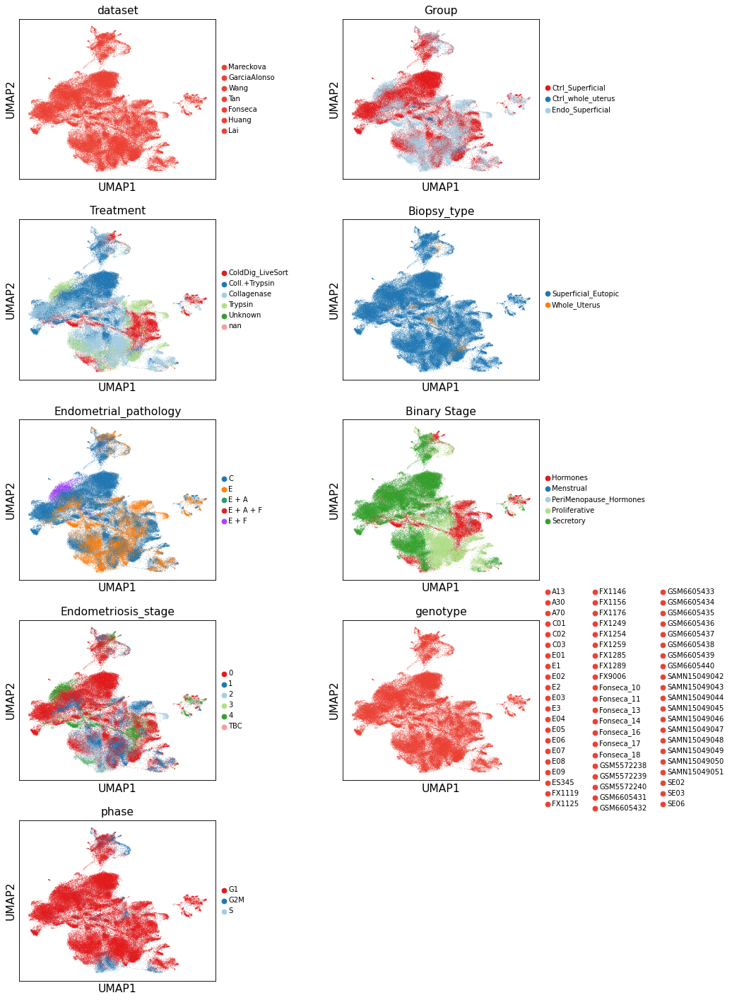

In [6]:
sc.pl.umap(adata, color=['dataset', 'Group', 'Treatment', 'Biopsy_type', 'Endometrial_pathology', 'Binary Stage', 'Endometriosis_stage', 'genotype', 'phase'], wspace=0.5, legend_fontsize=9, ncols=2, save='_allcells_metadata.pdf')

In [7]:
# annot_df = pd.read_csv('/nfs/team292/lg18/endometriosis/annotations/cells_endometrium.csv',index_col=0)
# annot_df.head()

# annot = annot_df['Mareckova_celltype'].to_dict()
# adata.obs['Mareckova_celltype'] = adata.obs_names.map(annot)
# print(adata.obs['Mareckova_celltype'].value_counts())

annot_df = pd.read_csv('/nfs/team292/lg18/endometriosis/annotations/cells_endometrium_epithelial.csv',index_col=0)
annot_df.head()

annot = annot_df['Mareckova_epi_celltype'].to_dict()
adata.obs['Mareckova_epi_celltype'] = adata.obs_names.map(annot)
print(adata.obs['Mareckova_epi_celltype'].value_counts())

/home/jovyan/my-conda-envs/sc_analysis/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3166: DtypeWarning: Columns (5,8,10,11,14,15,16,17,18,19,20,21,22,23,24,25,26,39,40,41,42,46,47,55,56,58,59,60,69) have mixed types.Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


Hormones                 15028
preGlands                14418
SOX9                     14034
Lumen                    13031
Glands                   12050
Glands_secretory          8893
LowQC                     8078
Doublet                   7442
Ciliated                  6236
Cycling                   4542
SOX9_lumen                4396
MUC5B                     1573
SOX9_basal                1032
Glands_secretory_late      930
preCiliated                707
KRT5                       539
Other                       44
Name: Mareckova_epi_celltype, dtype: int64


... storing 'Mareckova_epi_celltype' as categorical


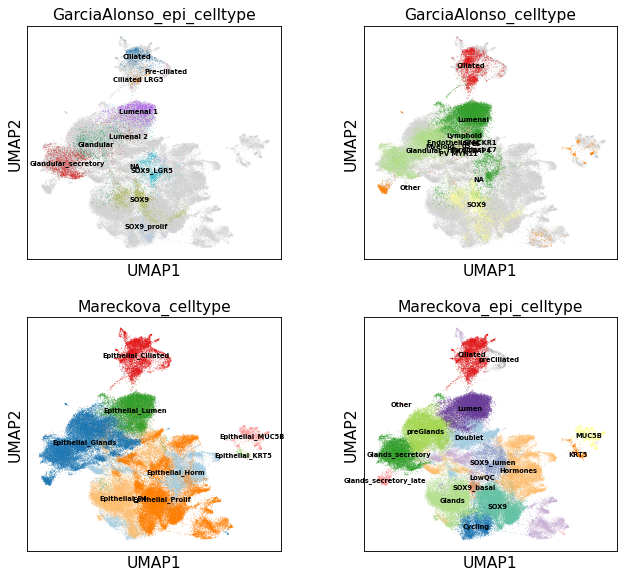

In [8]:
adata.obs['GarciaAlonso_epi_celltype'] = adata.obs['GarciaAlonso_epi_celltype'].replace('nan', np.NaN)
adata.obs['GarciaAlonso_celltype'] = adata.obs['GarciaAlonso_celltype'].replace('nan', np.NaN)
sc.pl.umap(adata, color=['GarciaAlonso_epi_celltype', 'GarciaAlonso_celltype', 'Mareckova_celltype', 'Mareckova_epi_celltype'], legend_loc='on data', ncols = 2, legend_fontsize=6)

### Visualize general markers

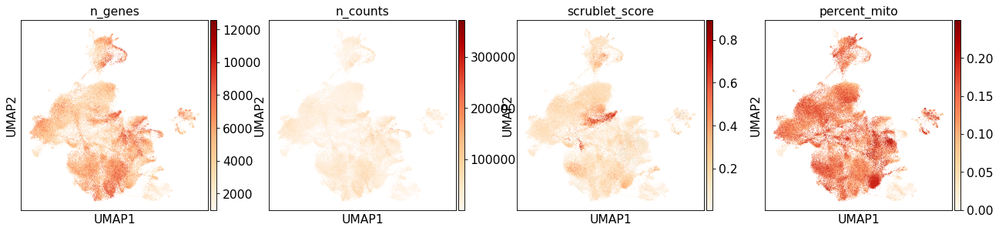

In [9]:
sc.pl.umap(adata, color=['n_genes','n_counts','scrublet_score', 'percent_mito'], color_map='OrRd')

In [10]:
sc.pp.normalize_per_cell(adata, counts_per_cell_after=1e4)
sc.pp.log1p(adata)

normalizing by total count per cell
/home/jovyan/my-conda-envs/sc_analysis/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)
    finished (0:00:06): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)


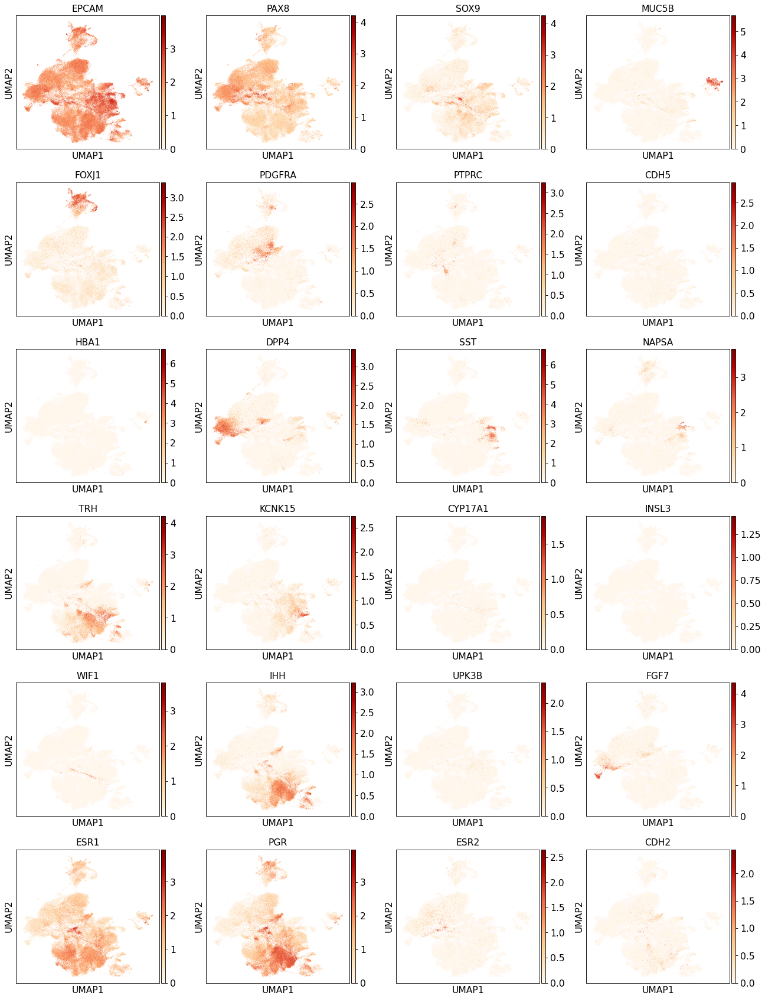

In [11]:
sc.pl.umap(adata, color=["EPCAM", "PAX8", 'SOX9', 'MUC5B', 'FOXJ1',  "PDGFRA", 'PTPRC', 'CDH5', 'HBA1', 'DPP4', 'SST', 'NAPSA', 'TRH','KCNK15',
                        "CYP17A1", "INSL3", "WIF1",  'IHH', 'UPK3B', 'FGF7', 'ESR1', 'PGR', 'ESR2', 'CDH2'], color_map='OrRd', use_raw=False )

## Clustering the graph
As Seurat and many others, we use the leiden graph-clustering method (community detection based on optimizing modularity). It has been proposed for single-cell data by Levine et al. (2015).

In [12]:
sc.tl.leiden(adata, resolution=0.75)

running Leiden clustering
    finished: found 20 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:36)


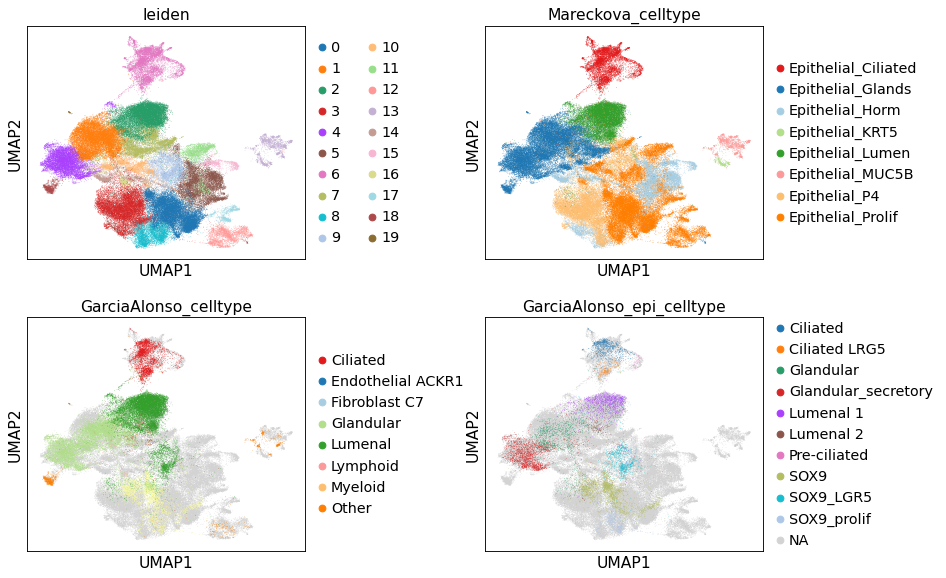

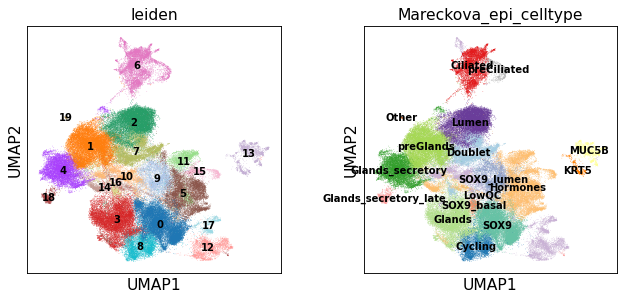

In [13]:
sc.pl.umap(adata, color=['leiden',  'Mareckova_celltype','GarciaAlonso_celltype', 'GarciaAlonso_epi_celltype'], wspace=0.5, ncols=2)
sc.pl.umap(adata, color=['leiden', 'Mareckova_epi_celltype'],legend_loc='on data', legend_fontsize=9)

running Leiden clustering
    finished: found 22 clusters and added
    'leiden_R', the cluster labels (adata.obs, categorical) (0:00:02)


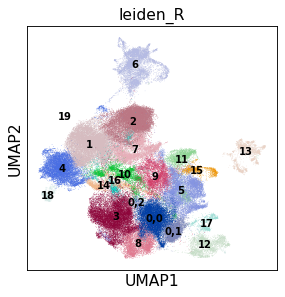

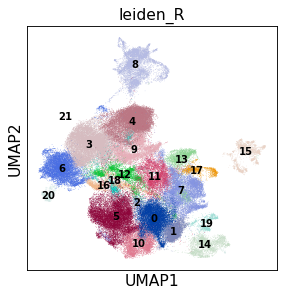

In [14]:
# recluster
sc.tl.leiden(adata, resolution=0.15, restrict_to=('leiden', ['0']))
sc.pl.umap(adata, color='leiden_R',legend_loc='on data', legend_fontsize=9)
adata.obs['leiden_R'].cat.categories = [str(i) for i in range(len(adata.obs['leiden_R'].cat.categories))]
sc.pl.umap(adata, color='leiden_R',legend_loc='on data', legend_fontsize=9)
adata.obs['leiden'] = adata.obs['leiden_R']

running Leiden clustering
    finished: found 25 clusters and added
    'leiden_R', the cluster labels (adata.obs, categorical) (0:00:00)


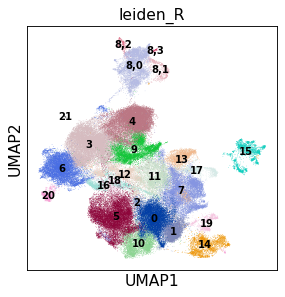

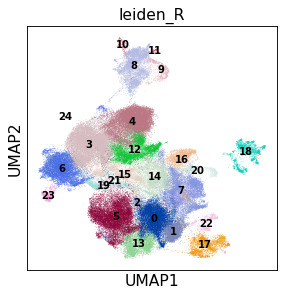

In [15]:
# recluster
sc.tl.leiden(adata, resolution=0.1, restrict_to=('leiden', ['8']))
sc.pl.umap(adata, color='leiden_R',legend_loc='on data', legend_fontsize=9)
adata.obs['leiden_R'].cat.categories = [str(i) for i in range(len(adata.obs['leiden_R'].cat.categories))]
sc.pl.umap(adata, color='leiden_R',legend_loc='on data', legend_fontsize=9)
adata.obs['leiden'] = adata.obs['leiden_R']

running Leiden clustering
    finished: found 27 clusters and added
    'leiden_R', the cluster labels (adata.obs, categorical) (0:00:00)


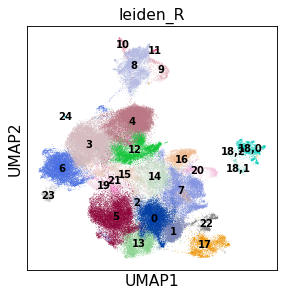

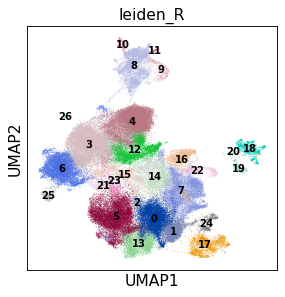

In [16]:
# recluster
sc.tl.leiden(adata, resolution=0.05, restrict_to=('leiden', ['18']))
sc.pl.umap(adata, color='leiden_R',legend_loc='on data', legend_fontsize=9)
adata.obs['leiden_R'].cat.categories = [str(i) for i in range(len(adata.obs['leiden_R'].cat.categories))]
sc.pl.umap(adata, color='leiden_R',legend_loc='on data', legend_fontsize=9)
adata.obs['leiden'] = adata.obs['leiden_R']

### Check global trends

/home/jovyan/my-conda-envs/sc_analysis/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)
Trying to set attribute `.uns` of view, copying.


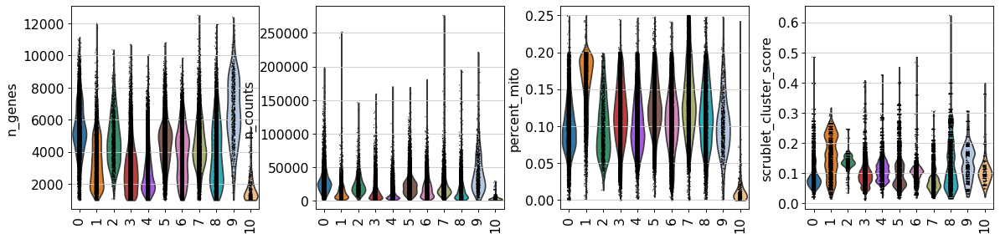

/home/jovyan/my-conda-envs/sc_analysis/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)
Trying to set attribute `.uns` of view, copying.


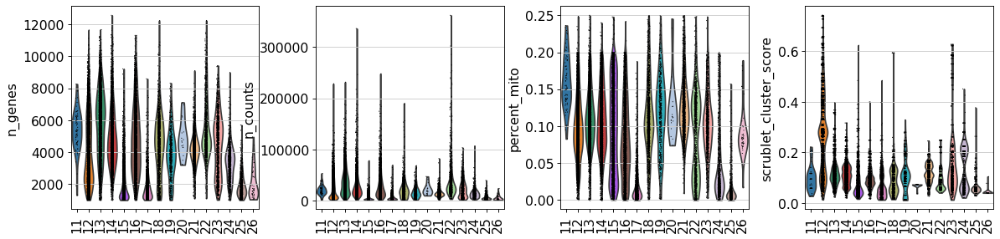

In [17]:
sc.pl.violin(adata[[ float(i) <= 10 for i in adata.obs.leiden ]], keys= ['n_genes', 'n_counts', 'percent_mito', 'scrublet_cluster_score'], groupby = 'leiden', rotation = 90)
sc.pl.violin(adata[[ float(i) > 10 for i in adata.obs.leiden ]], keys= ['n_genes', 'n_counts', 'percent_mito', 'scrublet_cluster_score'], groupby = 'leiden', rotation = 90)
# sc.pl.violin(adata, keys= ['percent_mito', 'scrublet_score', 'scrublet_cluster_score'], groupby = 'leiden_R', rotation = 90)

# Finding marker genes

Compute a ranking for the highly differential genes in each cluster. Here, we simply rank genes with a t test, which agrees quite well with Seurat.

## All vs rest

In [18]:
# # Compute Mann-Withney test with scanpy
# sc.tl.rank_genes_groups(adata, groupby='leiden', use_raw=False) #, method='logreg'
# # Plot
# sc.pl.rank_genes_groups_dotplot(adata, n_genes=20, dendrogram=False, save='_scanpy.pdf', standard_scale = 'var')

In [19]:
def Barplot(which_var, adata, var='lineage', height=3, color = False):
    plotdata = pd.crosstab(adata.obs[var], adata.obs[which_var], normalize='index') * 100
    if 'category' in plotdata.index.dtype.name:
        plotdata.index.reorder_categories(adata.obs[var].cat.categories[::-1])

    if not color:
        ax1 = plotdata.plot.barh(stacked = True, edgecolor = 'none', zorder = 3, figsize = (6,height), fontsize = 14, grid = False)
    else:
        ax1 = plotdata.plot.barh(stacked = True, edgecolor = 'none', zorder = 3, figsize = (6,height), fontsize = 14, grid = False, color = color)
    ax1.set_title(which_var+' %')
    ax1.set_ylabel(var)
    horiz_offset = 1
    vert_offset = 1.
    ax1 = ax1.legend(bbox_to_anchor = (horiz_offset, vert_offset))
    ax1.figure.savefig(str(sc.settings.figdir)+'/barplot_'+var+'_proportions_'+which_var+'.pdf', bbox_inches='tight',
                       dpi=300, orientation='landscape', format= 'pdf', optimize=True)

/home/jovyan/my-conda-envs/sc_analysis/lib/python3.7/site-packages/ipykernel_launcher.py:16: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "optimize" which is no longer supported as of 3.3 and will become an error two minor releases later
  app.launch_new_instance()
/home/jovyan/my-conda-envs/sc_analysis/lib/python3.7/site-packages/ipykernel_launcher.py:16: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "optimize" which is no longer supported as of 3.3 and will become an error two minor releases later
  app.launch_new_instance()
/home/jovyan/my-conda-envs/sc_analysis/lib/python3.7/site-packages/ipykernel_launcher.py:16: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "optimize" which is no longer supported as of 3.3 and will become an error two minor releases later
  app.launch_new_instance()
/home/jovyan/my-conda-envs/sc_analysis/lib/python3.7/site-packages/ipykernel_launcher.py:16: MatplotlibDeprecationWarning

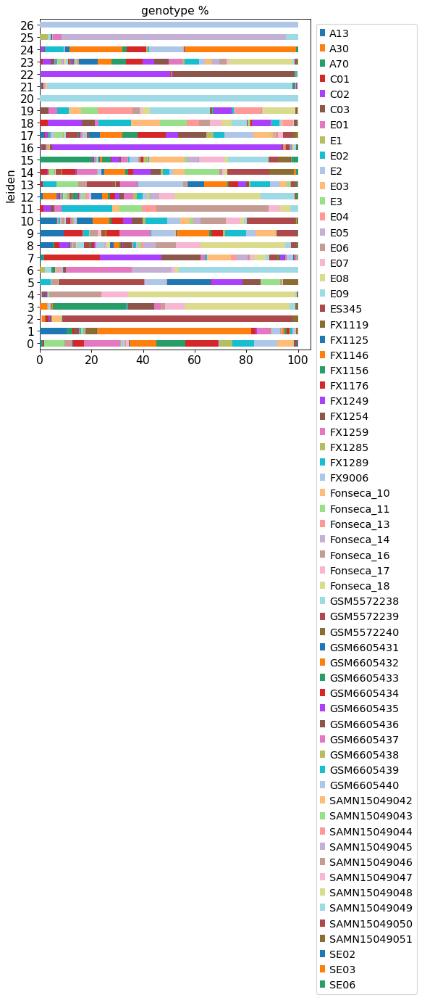

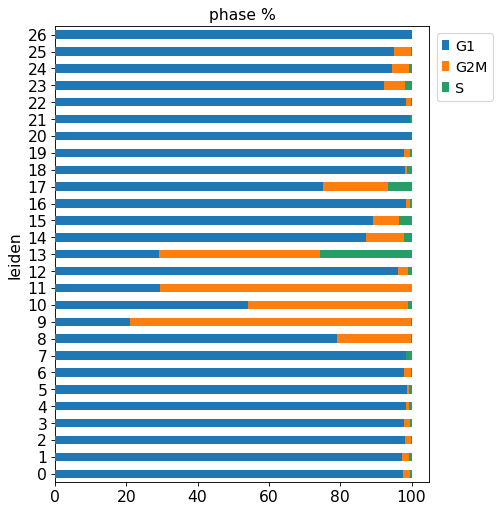

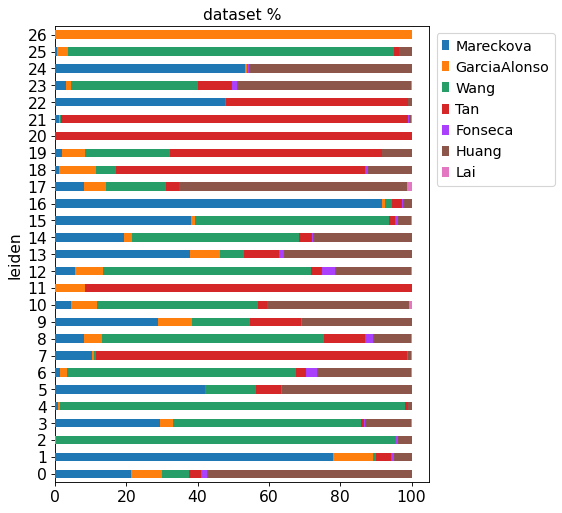

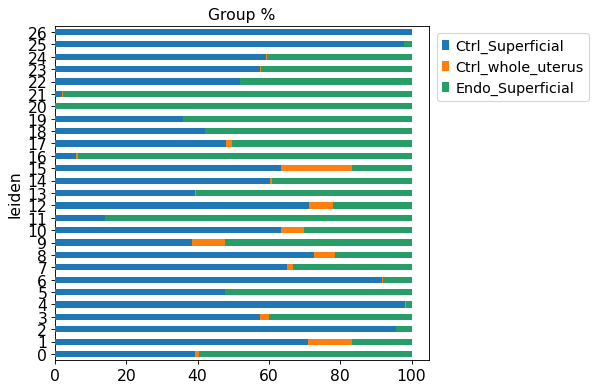

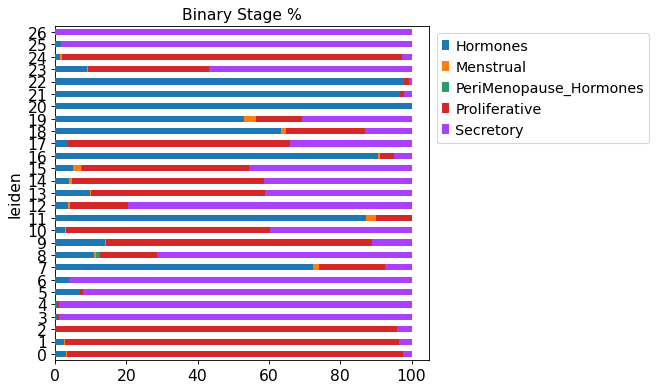

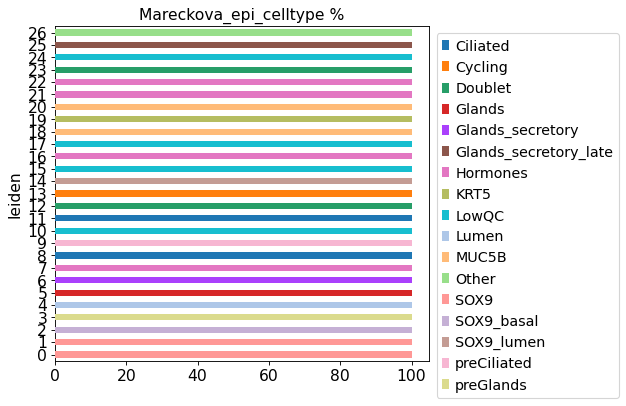

In [20]:
Barplot('genotype', adata, var='leiden', height=7.5)
Barplot('phase', adata, var='leiden', height=7.5)
Barplot('dataset', adata, var='leiden', height=7.5)
Barplot('Group', adata, var='leiden', height=5.5)
Barplot('Binary Stage', adata, var='leiden', height=5.5)
Barplot('Mareckova_epi_celltype', adata, var='leiden', height=5.5)

In [21]:
marker_genes = {
    'Epithelial lineage': {'EPCAM', 'PAX8'},
    'Proliferative':{"HPGD", 'MMP7', 'IHH', "SPDEF", "TRH", "EMID1", "KMO", 'OVGP1', 'ADAMTS6'},
    'Proliferative SOX9+':{'SOX9', 'TRAF3IP3', 'BACH2', 'ZHX2', 'CCNA1', 'GLS', 'IGF2BP2',  'PLAU', 'CREB5'},
    'SOX9+/CDH2+':{'CDH2', 'PRDM1' ,'AREG', 'PHLDA1', 'SLC7A11', 'AQP3', 'DKK1'},
    'SOX9+/LGR5+':{'LGR5', 'WNT7A', 'TNF', 'CLDN22', 'CD109', 'EMILIN2', 'CXCL1', 'NRP1', 'B3GNT7', 'AKAP12'}, #'SEMA3A', 'NALCN'
    'P4-induced':{'SUFU', 'CBR3', 'TENM2', 'CST1','OPRK1', 'HPGD', 'PLXNA4', 'SLC16A1'},
    'luteal' :{'MT1M', 'MT1H', 'CRYAB'},
    'Lumenal':{'SULT1E1',  'LEFTY1', 'PTGS2', 'RAB27B', 'PTGS1', 'LGR5', 'IL6', 'CDH16', 'BAALC'},
    'Lumenal early':{'HEY1', 'ABCG1', 'CAPN6', 'CYP26A1', 'SPARCL1'},
    'Lumenal late':{'MYLK', 'CLDN22'},
    'pre-WOI' :{'MMP26'},
    'Glandular': {'SLC18A2', 'C2CD4A', 'SCGB2A2', 'GAST', 'S100P'}, # 'SSP1', 
    'Glandular secretory': {'DPP4', 'PAEP', 'COMP', 'TSPAN8', 'FGF7', 'FXYD2', 'PTPRR'}, # 'SSP1',   
    'MUC5B+':{"MUC5B",   "STRA6", "LTF"}, # , "BPIFB1"
    'KRT5/TP63':{'KRT5', 'TP63', 'SNCG'}, 
    'Menstrual':{'SST'},
    'Ciliated lineage': {'PIFO', 'FOXJ1', 'TP73'},
    'pre-Ciliated':{"MUC12", 'CDC20B', 'CCNO'},
    'Mesenchymal lineage': {"PDGFRA", 'OGN','DCN', 'LUM'},
#     'Fibroblast C7': {'C7'},
    'eS':{'MMP11', 'CRABP2', 'ECM1'},
    'dS':{'DKK1', 'IL15', 'CFD'},
    'PV lineage':{'MYH11', 'ACTA2', "MCAM"},
    'Endothelial': {'PECAM1', 'VWF', 'CDH5'},
    'Immune': {'PTPRC'},
    'Lymphoid': {'CD3D', 'NCAM1' , 'NKG7'},
    'Myeloid': {'CSF1R', 'CD14'},
    'lowQC': {"HBA1", "HBA2"},
    'WIF1':{'WIF1', 'NKD1', 'NRN1', 'AZGP1'},
    'Hormones':{'KCNK15'},
#     'HOXBs':{'HOXB8', 'HOXB4', 'HOXB5', 'HOXB6'},
    'Mesothelial': {"KLK11", 'UPK3B'}, #, 'LRRN4'
    'Prostaglandin R':{'PTGER4','PTGFR', 'PTGER3', 'PTGIR', 'PTGDR', 'PTGDR2', 'PTGER1', 'PTGER2'},
    'Prostaglandin S':{ 'PTGES', 'HPGDS', 'PTGS1', 'TBXAS1', 'PTGS2', 'PTGDS', 'PLA2G4A', 'PTGES3', 'PTGIS', 'PTGES2'},
    'MMPs':{'MMP7','MMP11',  'MMP24', 'MMP26'},
#     'Granulosa': {"AMH", "GATA4", 'WNT6', 'GSTA1'},
#     'Theca': {"CYP17A1", "INSL3", 'PTCH2'}
#     'cycling': {'CDK1', 'MKI67', 'TOP2A'}
}

marker_genes_short = {
    'Epithelial lineage': {'EPCAM', 'PAX8'}, 
    'Mesothelial': {'UPK3B', 'KLK11'},
    'Mesenchymal lineage': {"PDGFRA", 'OGN'}, # 'DCN', 'LUM'
    'PV lineage':{'MYH11', 'ACTA2', "MCAM"},
    'uSMCs':{'LEFTY2', 'ACTG2', 'ITGA11'},
    'Endothelial': {'PECAM1', 'VWF', 'CDH5'},
    'Immune': {'PTPRC'},
    'Lymphoid': {'CD3D', 'NCAM1' , 'NKG7'},
    'Myeloid': {'CSF1R', 'CD14'},
    'Erythroid': {"HBB", "HBA1"}
}

Epithelial lineage


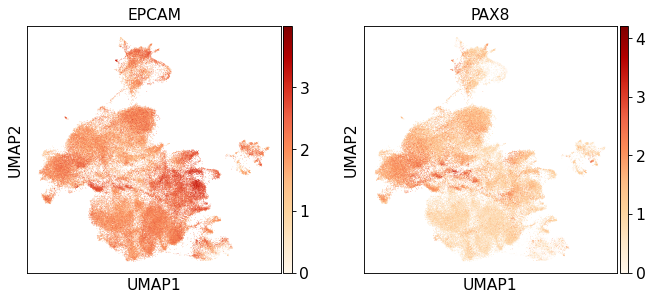

Proliferative


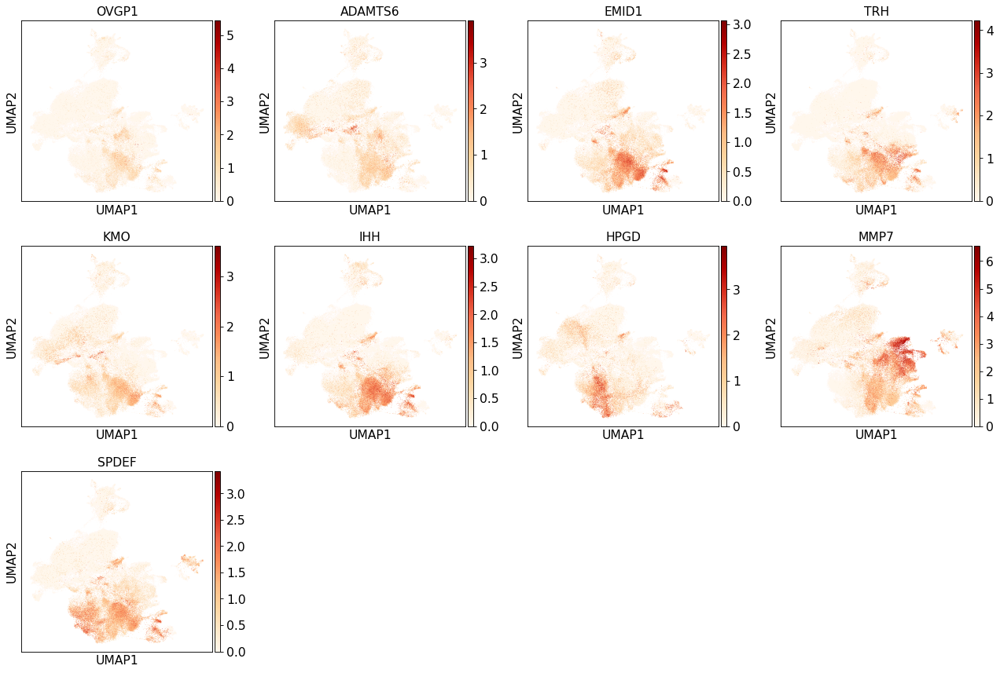

Proliferative SOX9+


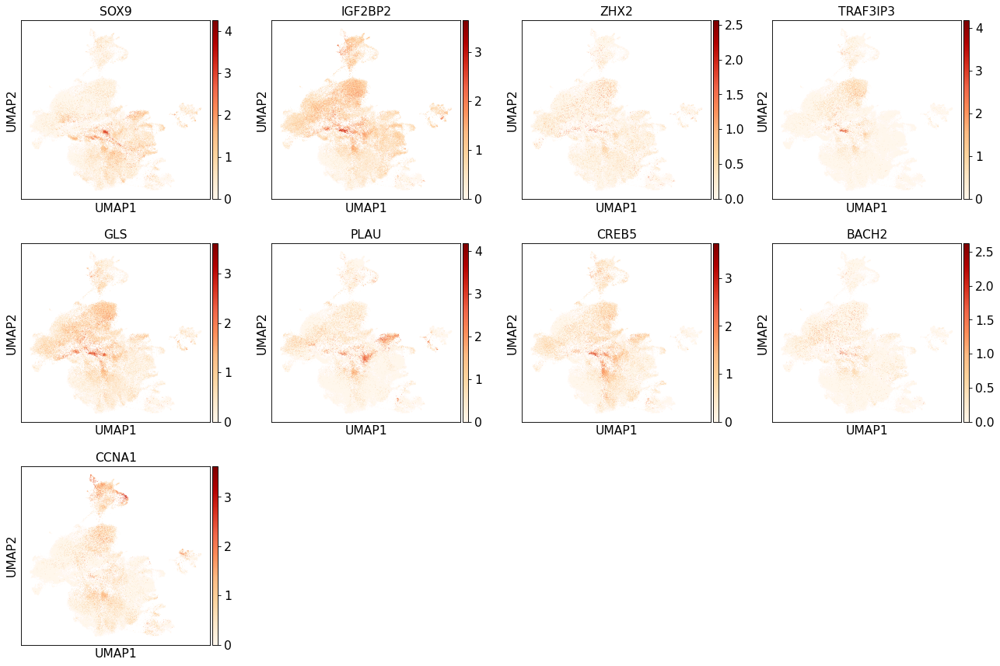

SOX9+/CDH2+


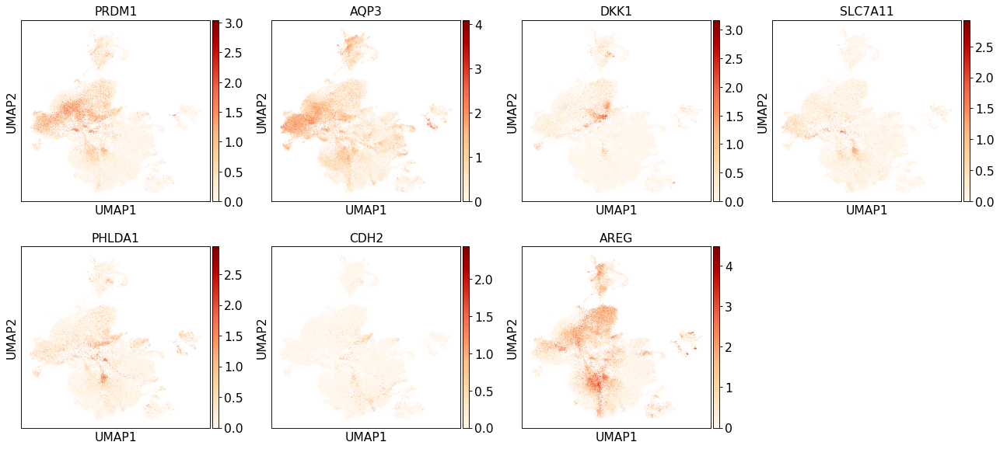

SOX9+/LGR5+


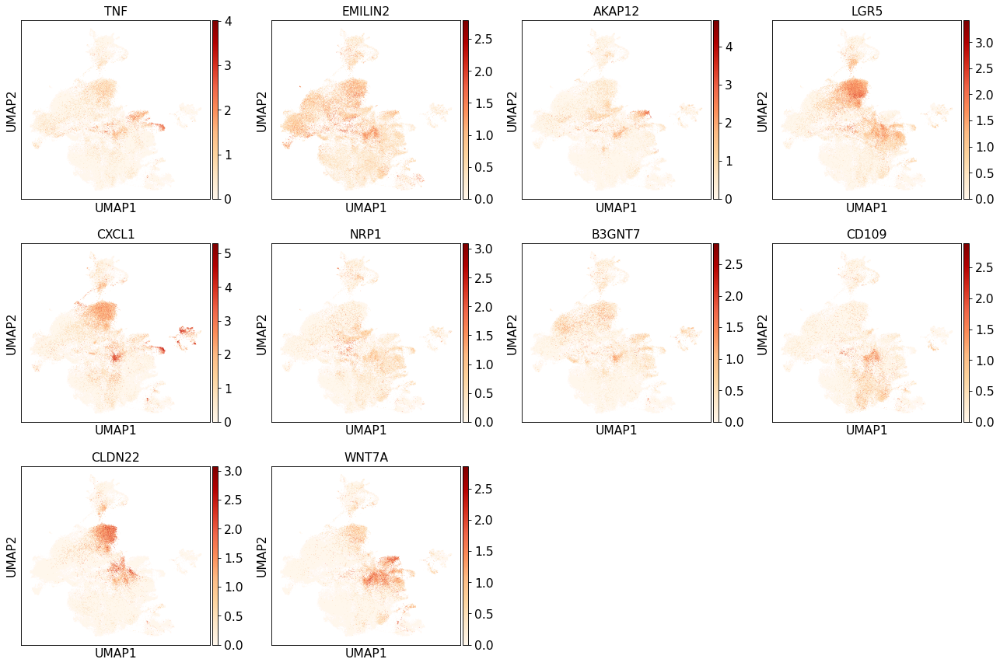

P4-induced


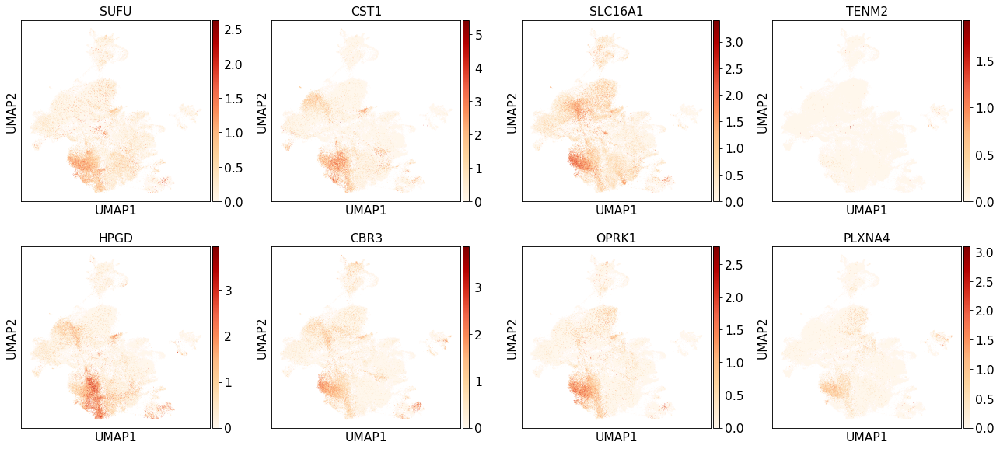

luteal


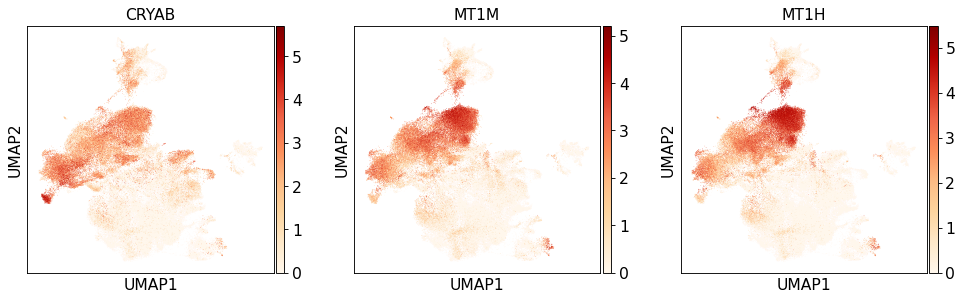

Lumenal


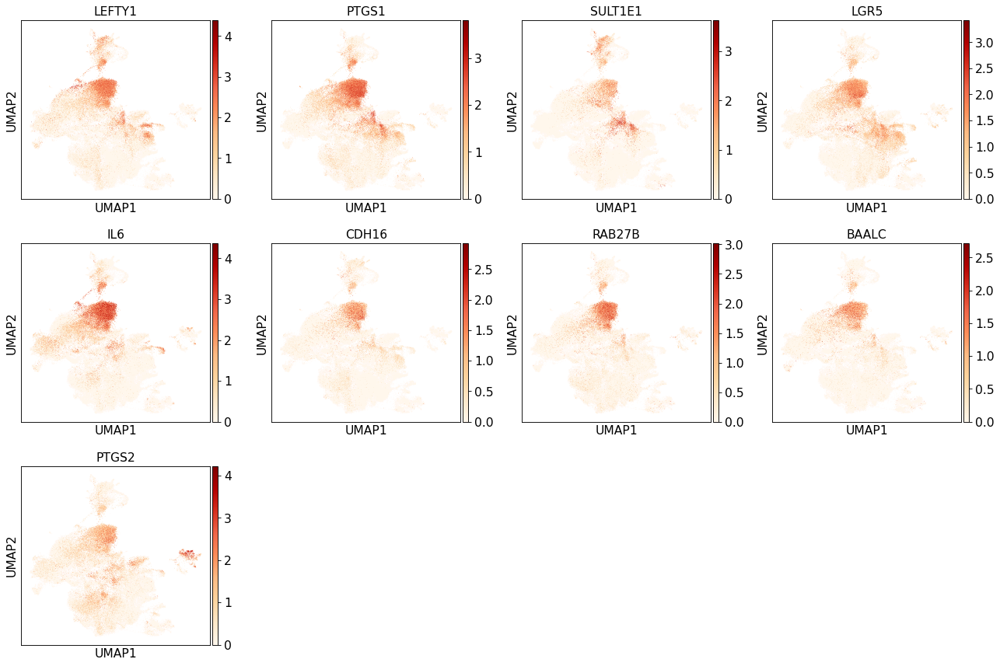

Lumenal early


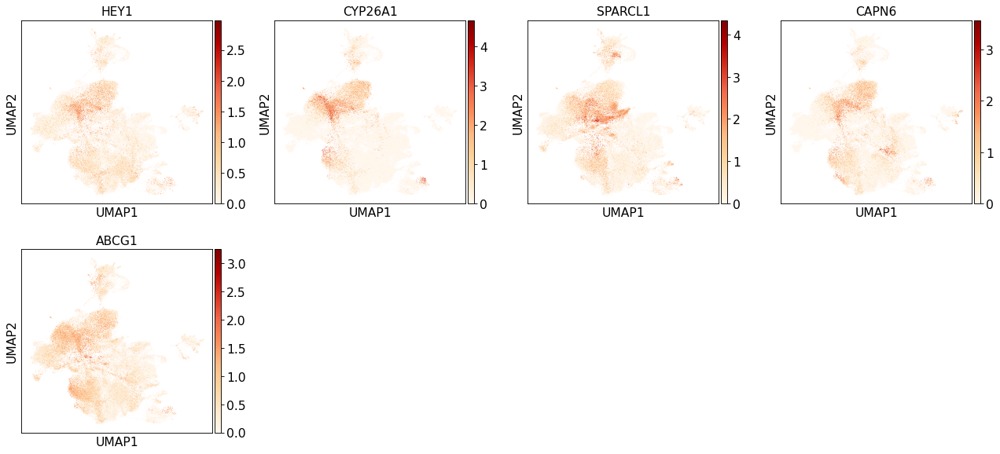

Lumenal late


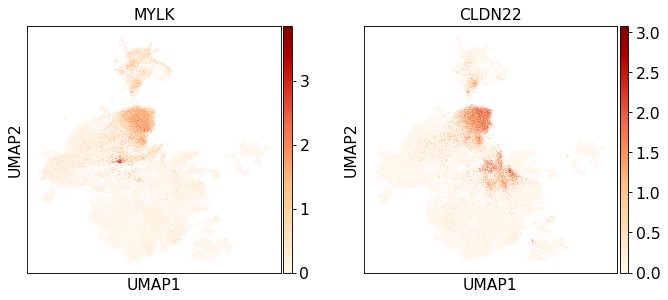

pre-WOI


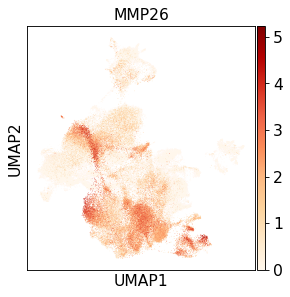

Glandular


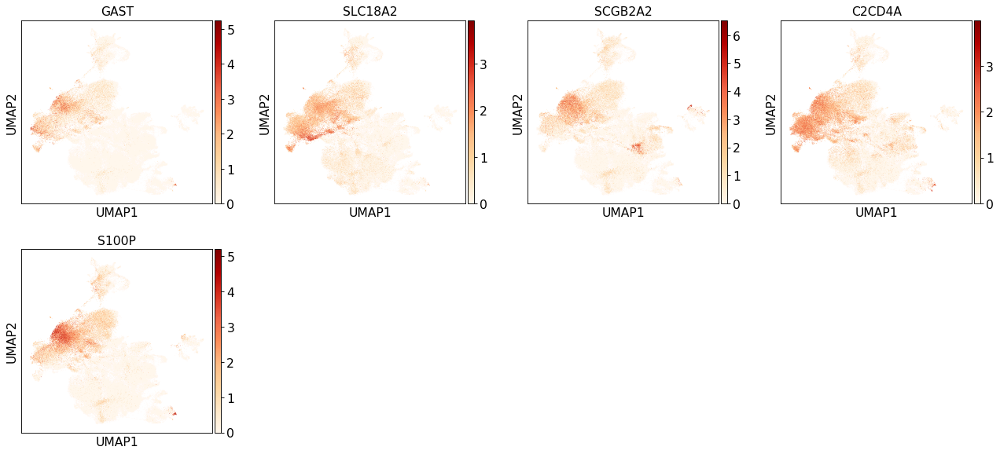

Glandular secretory


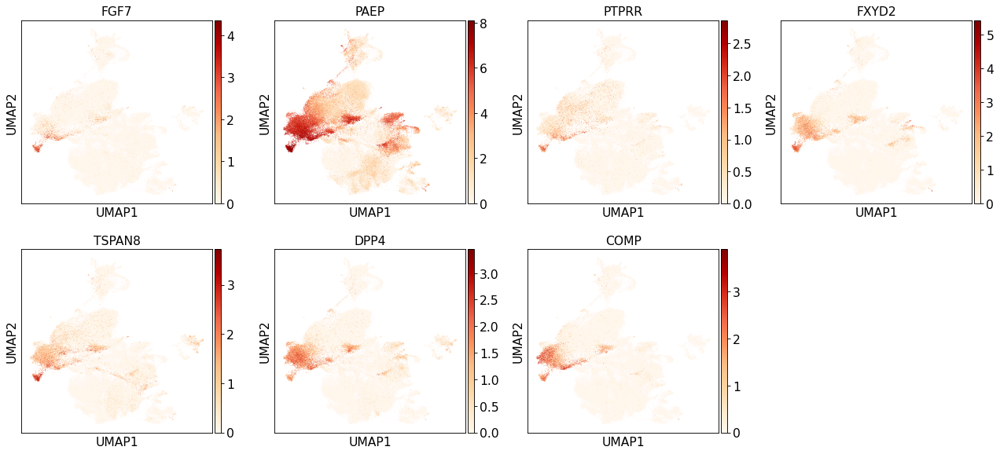

MUC5B+


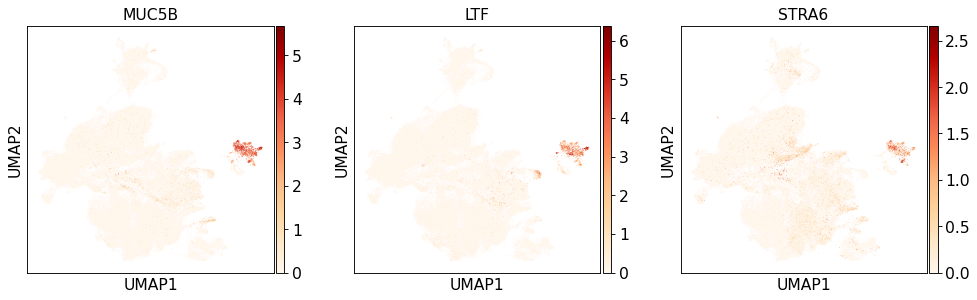

KRT5/TP63


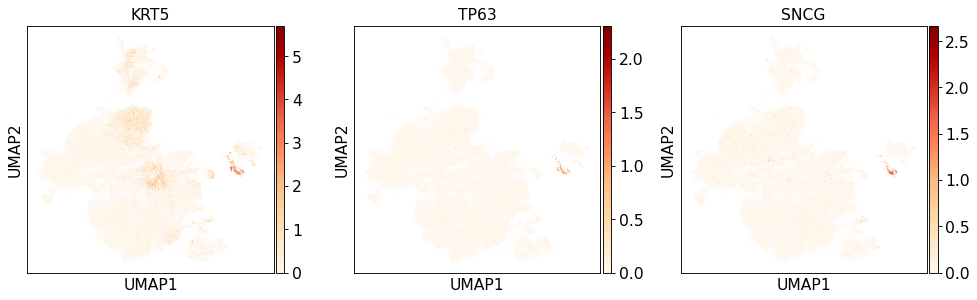

Menstrual


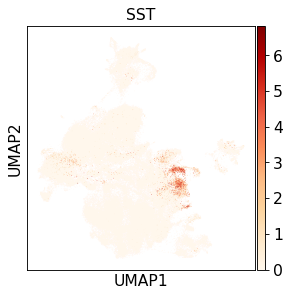

Ciliated lineage


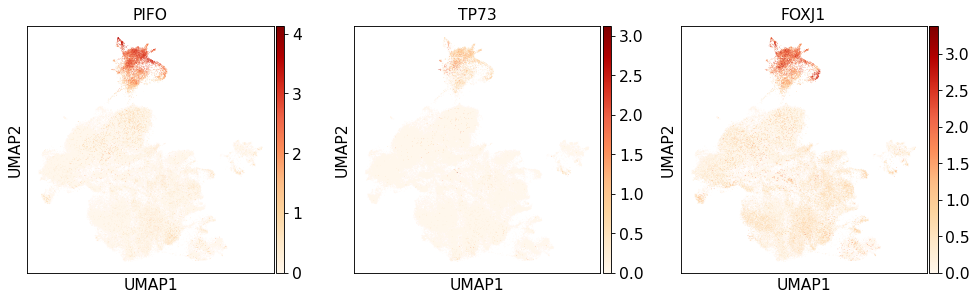

pre-Ciliated


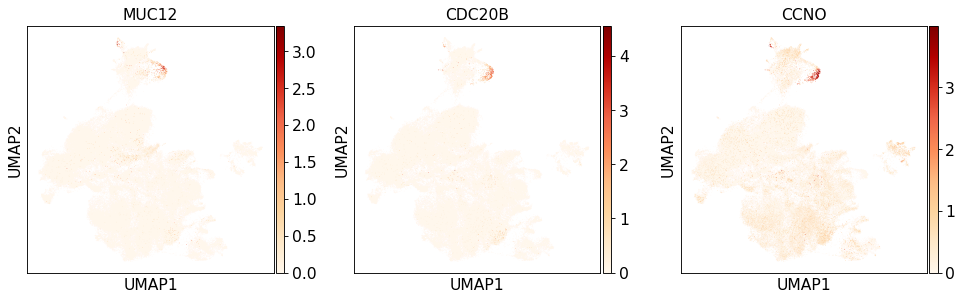

Mesenchymal lineage


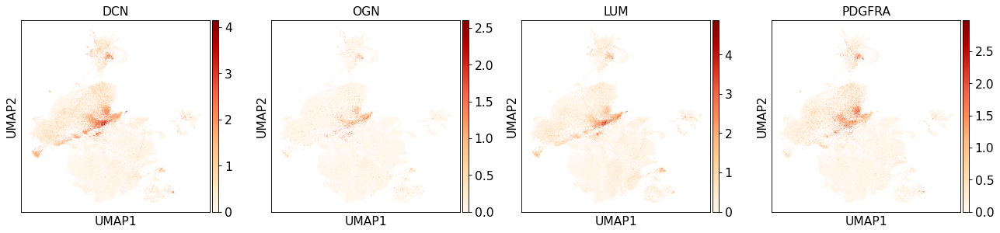

eS


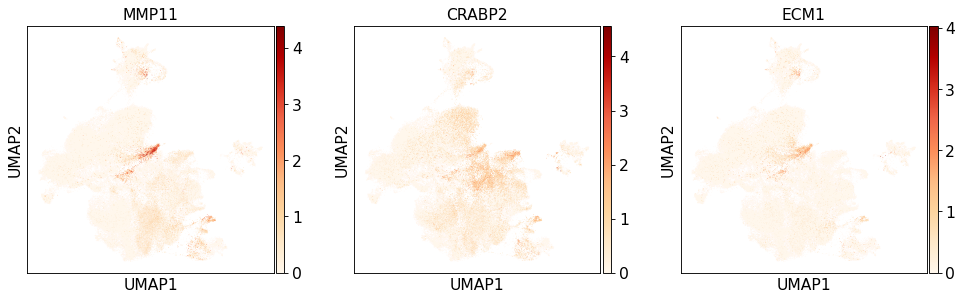

dS


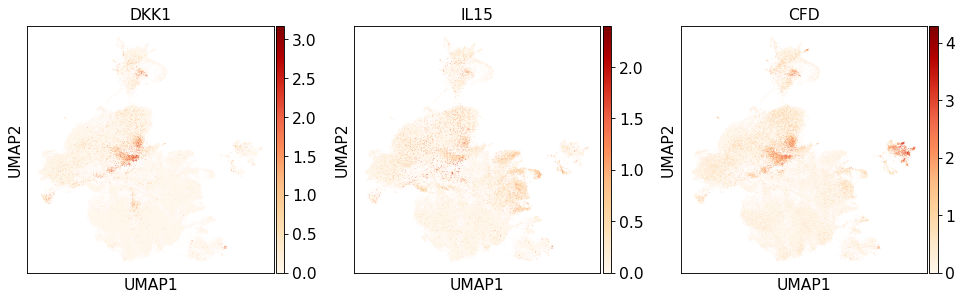

PV lineage


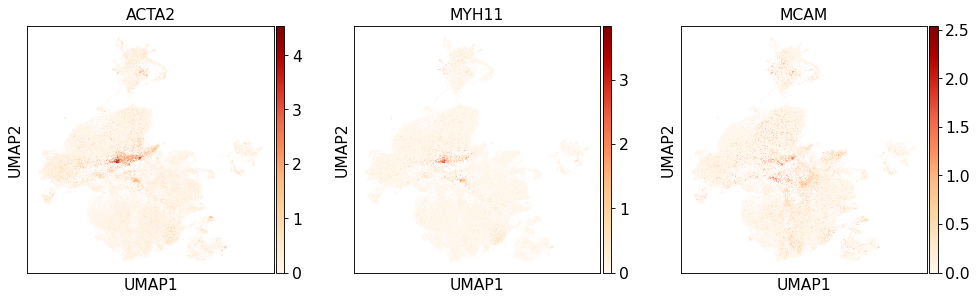

Endothelial


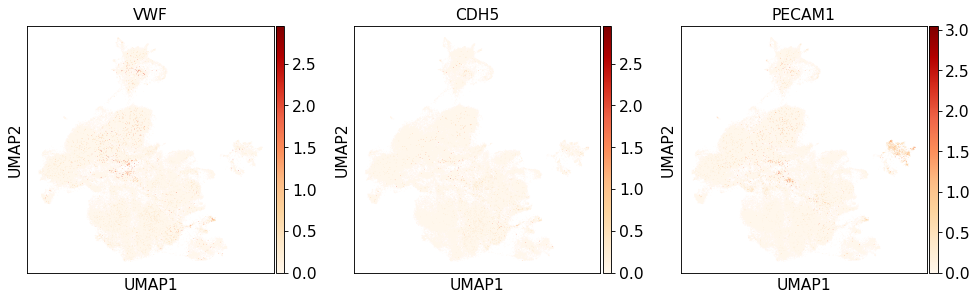

Immune


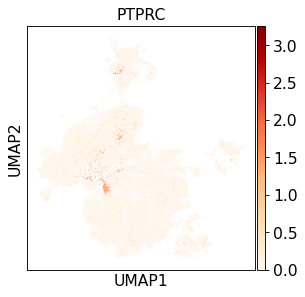

Lymphoid


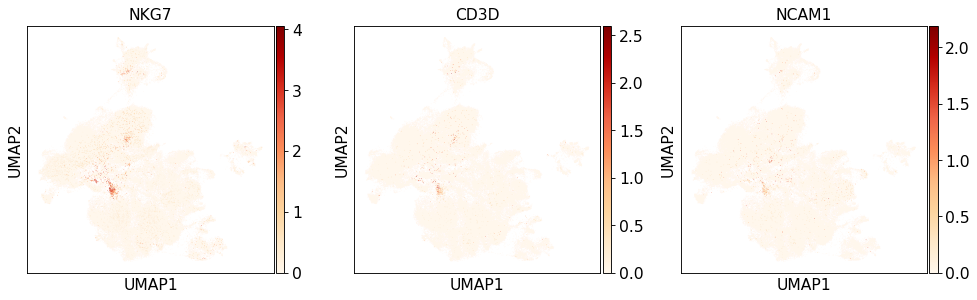

Myeloid


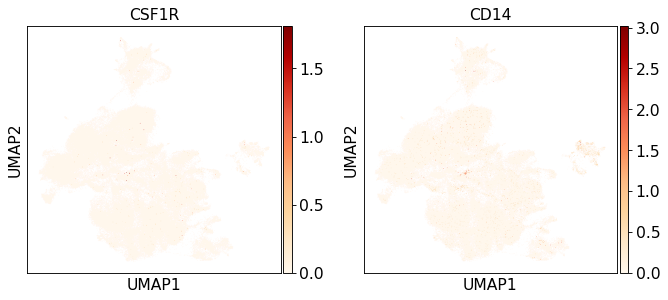

lowQC


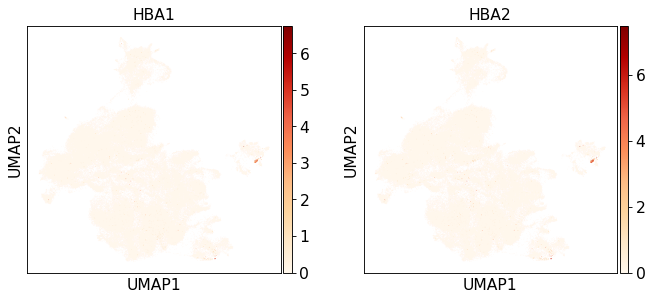

WIF1


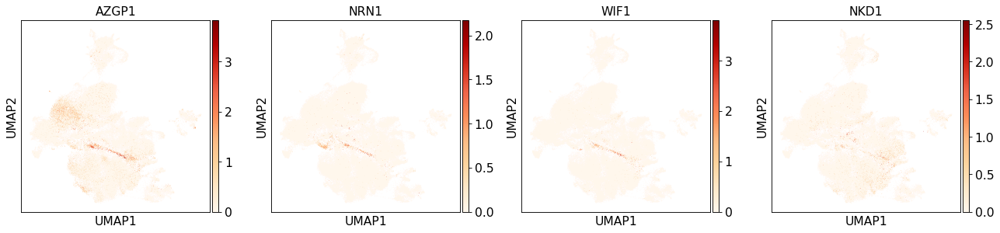

Hormones


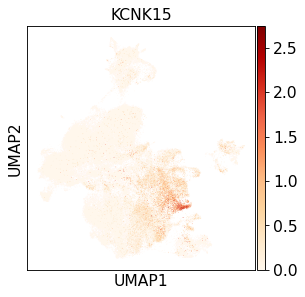

Mesothelial


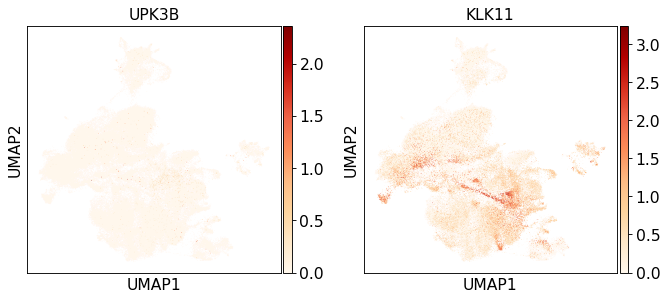

Prostaglandin R


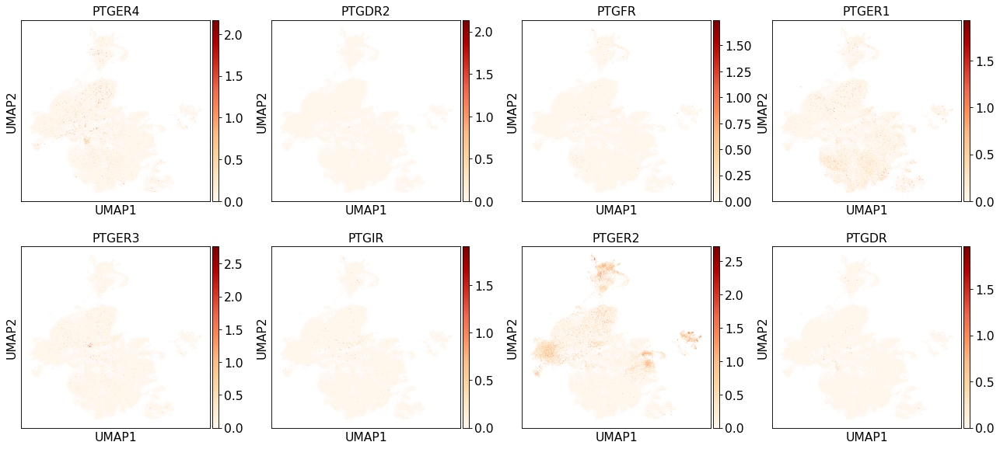

Prostaglandin S


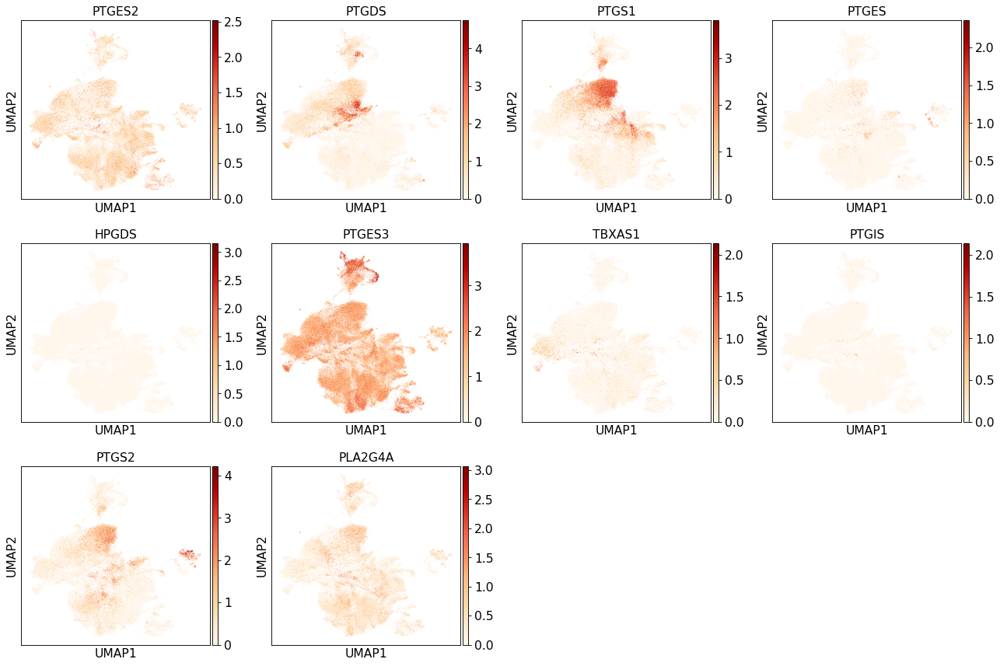

MMPs


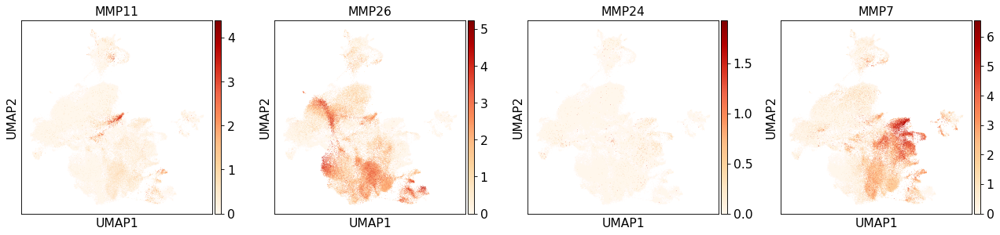

In [22]:
for i in marker_genes.keys():
    print(i)
    sc.pl.umap(adata, color=marker_genes[i], color_map='OrRd', use_raw=False )

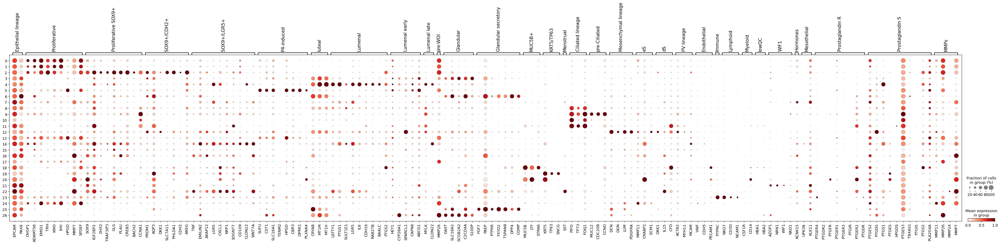

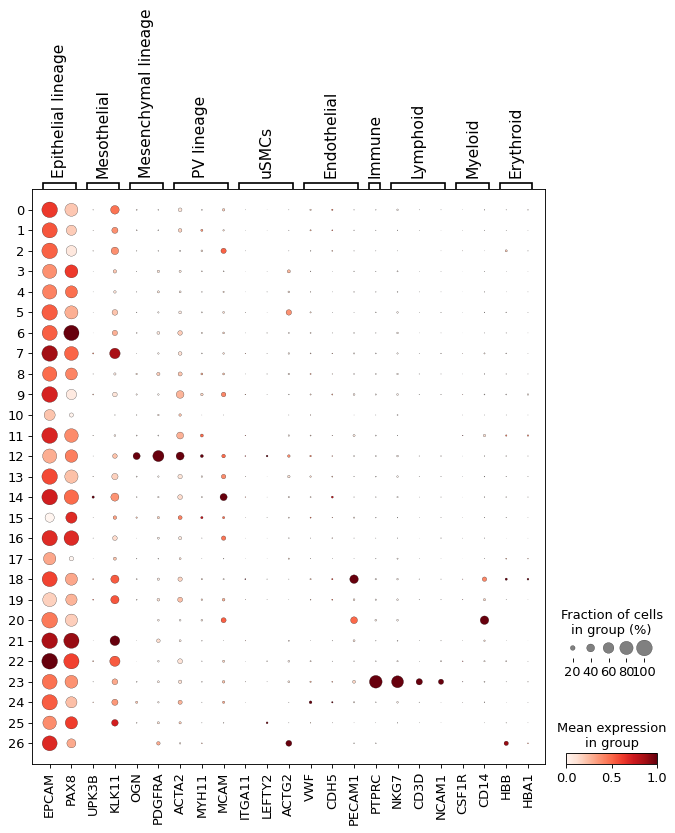

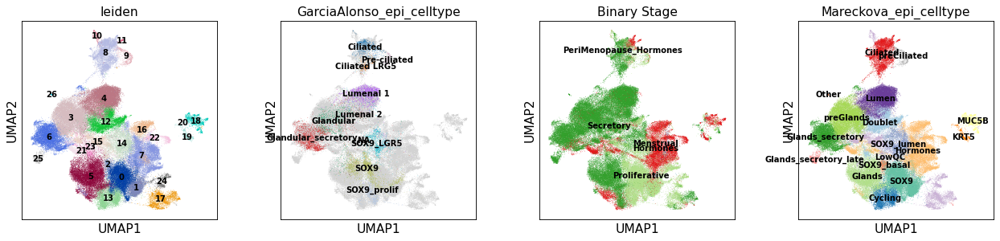

In [23]:
sc.pl.dotplot(adata, marker_genes, groupby='leiden', standard_scale='var', save='MARKERS_leiden.pdf')
sc.pl.dotplot(adata, marker_genes_short, groupby='leiden', standard_scale='var')


sc.pl.umap(adata, color=['leiden', 'GarciaAlonso_epi_celltype', 'Binary Stage', 'Mareckova_epi_celltype'],legend_loc='on data', legend_fontsize=9, save='_leiden.pdf')


... storing 'Mareckova_epi_celltype' as categorical
... storing 'Mareckova_epi_lineage' as categorical


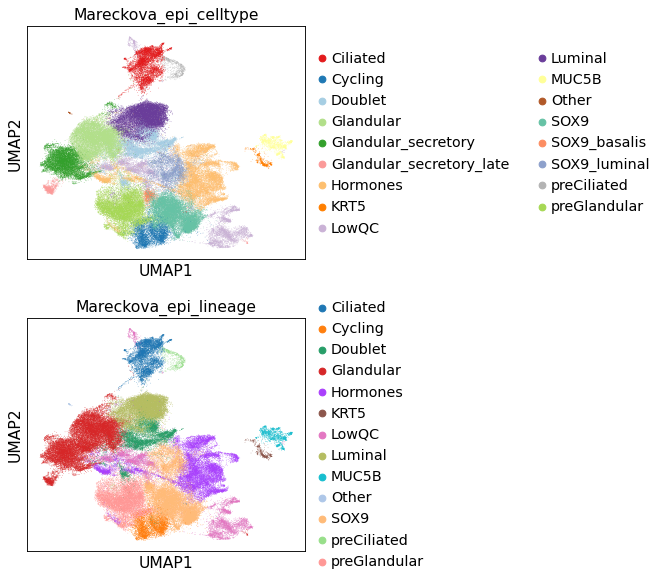

In [49]:
adata.obs['Mareckova_epi_celltype'] = adata.obs['leiden'].tolist()
adata.obs.at[adata.obs['Mareckova_epi_celltype'] == '0', 'Mareckova_epi_celltype'] = 'SOX9'
adata.obs.at[adata.obs['Mareckova_epi_celltype'] == '1', 'Mareckova_epi_celltype'] = 'SOX9'
adata.obs.at[adata.obs['Mareckova_epi_celltype'] == '2', 'Mareckova_epi_celltype'] = 'SOX9_basalis'
adata.obs.at[adata.obs['Mareckova_epi_celltype'] == '3', 'Mareckova_epi_celltype'] = 'Glandular'
adata.obs.at[adata.obs['Mareckova_epi_celltype'] == '4', 'Mareckova_epi_celltype'] = 'Luminal'
adata.obs.at[adata.obs['Mareckova_epi_celltype'] == '5', 'Mareckova_epi_celltype'] = 'preGlandular'
adata.obs.at[adata.obs['Mareckova_epi_celltype'] == '6', 'Mareckova_epi_celltype'] = 'Glandular_secretory'
adata.obs.at[adata.obs['Mareckova_epi_celltype'] == '7', 'Mareckova_epi_celltype'] = 'Hormones'
adata.obs.at[adata.obs['Mareckova_epi_celltype'] == '8', 'Mareckova_epi_celltype'] = 'Ciliated'
adata.obs.at[adata.obs['Mareckova_epi_celltype'] == '9', 'Mareckova_epi_celltype'] = 'preCiliated'
adata.obs.at[adata.obs['Mareckova_epi_celltype'] == '10', 'Mareckova_epi_celltype'] = 'LowQC'
adata.obs.at[adata.obs['Mareckova_epi_celltype'] == '11', 'Mareckova_epi_celltype'] = 'Ciliated'
adata.obs.at[adata.obs['Mareckova_epi_celltype'] == '12', 'Mareckova_epi_celltype'] = 'Doublet'
adata.obs.at[adata.obs['Mareckova_epi_celltype'] == '13', 'Mareckova_epi_celltype'] = 'Cycling'
adata.obs.at[adata.obs['Mareckova_epi_celltype'] == '14', 'Mareckova_epi_celltype'] = 'SOX9_luminal'

adata.obs.at[adata.obs['Mareckova_epi_celltype'] == '15', 'Mareckova_epi_celltype'] = 'LowQC'
adata.obs.at[adata.obs['Mareckova_epi_celltype'] == '16', 'Mareckova_epi_celltype'] = 'Hormones'
adata.obs.at[adata.obs['Mareckova_epi_celltype'] == '17', 'Mareckova_epi_celltype'] = 'LowQC'

adata.obs.at[adata.obs['Mareckova_epi_celltype'] == '18', 'Mareckova_epi_celltype'] = 'MUC5B'
adata.obs.at[adata.obs['Mareckova_epi_celltype'] == '19', 'Mareckova_epi_celltype'] = 'KRT5'
adata.obs.at[adata.obs['Mareckova_epi_celltype'] == '20', 'Mareckova_epi_celltype'] = 'MUC5B'
adata.obs.at[adata.obs['Mareckova_epi_celltype'] == '21', 'Mareckova_epi_celltype'] = 'Hormones'
adata.obs.at[adata.obs['Mareckova_epi_celltype'] == '22', 'Mareckova_epi_celltype'] = 'Hormones'

adata.obs.at[adata.obs['Mareckova_epi_celltype'] == '23', 'Mareckova_epi_celltype'] = 'Doublet'

adata.obs.at[adata.obs['Mareckova_epi_celltype'] == '24', 'Mareckova_epi_celltype'] = 'LowQC'
adata.obs.at[adata.obs['Mareckova_epi_celltype'] == '25', 'Mareckova_epi_celltype'] = 'Glandular_secretory_late'
adata.obs.at[adata.obs['Mareckova_epi_celltype'] == '26', 'Mareckova_epi_celltype'] = 'Other'



set(adata.obs['Mareckova_epi_celltype'])
adata.obs['Mareckova_epi_lineage'] = [str(i).split('_', 1)[0] for i in adata.obs['Mareckova_epi_celltype'] ]



sc.pl.umap(adata, color=['Mareckova_epi_celltype', 'Mareckova_epi_lineage'], ncols=1)
# adata.obs['Mareckova_epi_celltype'].cat.reorder_categories(['Epithelial', 'Epithelial_MUC5B', 'Epithelial_Glandular', 'Epithelial_Ciliated', 'Epithelial_TP63+KRT5+',
#                                                         'Mesothelial', 
#                                                         'Mesenchymal_eS', 'Mesenchymal_dS', 'Mesenchymal_C7', 
#                                                         'PV_STEAP4', 'PV_MYH11', 'uSMCs',
#                                                         'Endothelial', 'Endothelial_LEC', 'Myeloid', 'Lymphoid',
#                                                         'EcO_Mesenchymal',
#                                                         'EcO_Mesenchymal_COL10A1'
#                                                         'EcO_Granulosa', 'EcO_Theca',
#                                                         'LowQC', 'Doublet'], inplace=True)

# sc.pl.umap(adata, color=['Mareckova_epi_celltype'])

In [50]:
# del adata.uns['Mareckova_epi_celltype_colors']
# del adata.uns['Mareckova_epi_lineage_colors']

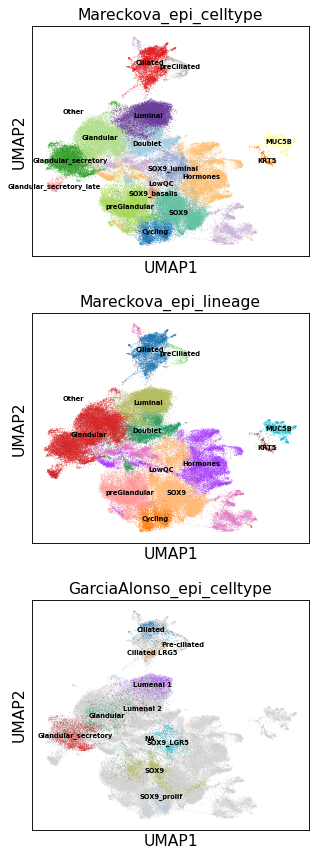

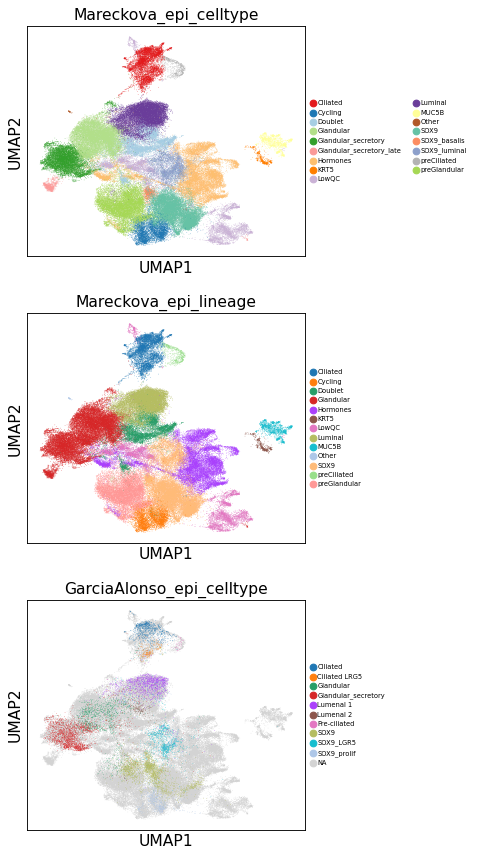

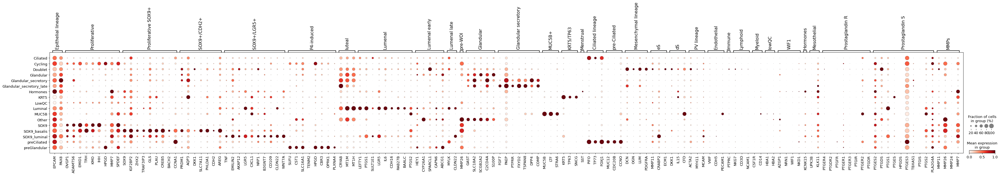

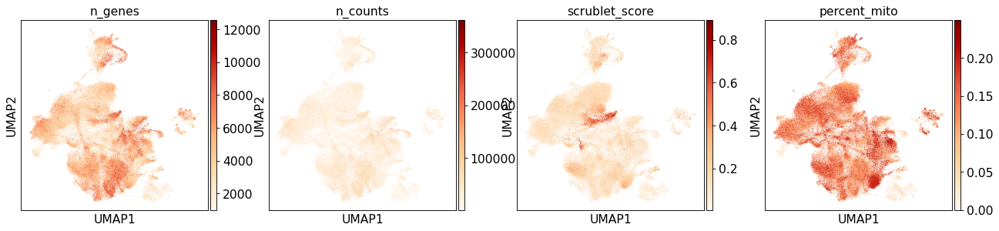

... storing 'leiden_celltype' as categorical
... storing 'celltype_leiden' as categorical


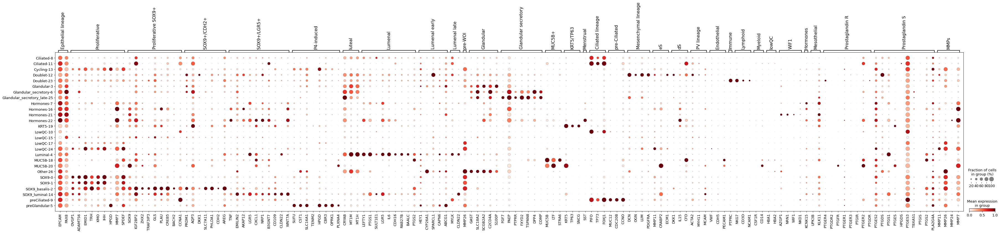

/home/jovyan/my-conda-envs/sc_analysis/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)
Trying to set attribute `.uns` of view, copying.


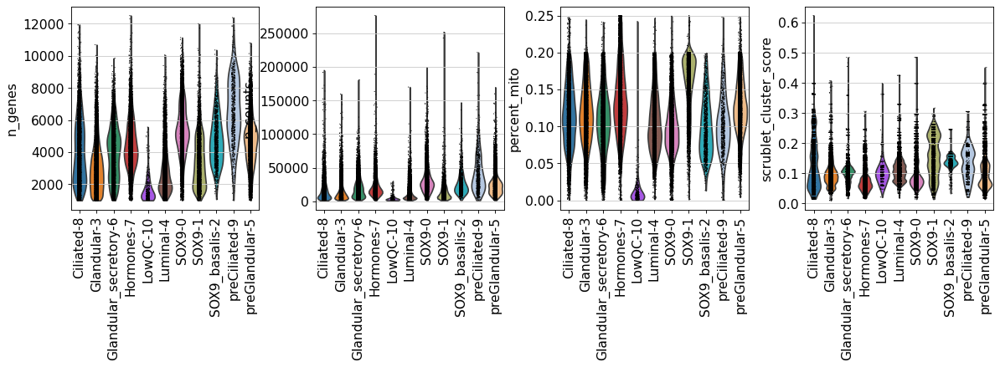

/home/jovyan/my-conda-envs/sc_analysis/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)
Trying to set attribute `.uns` of view, copying.


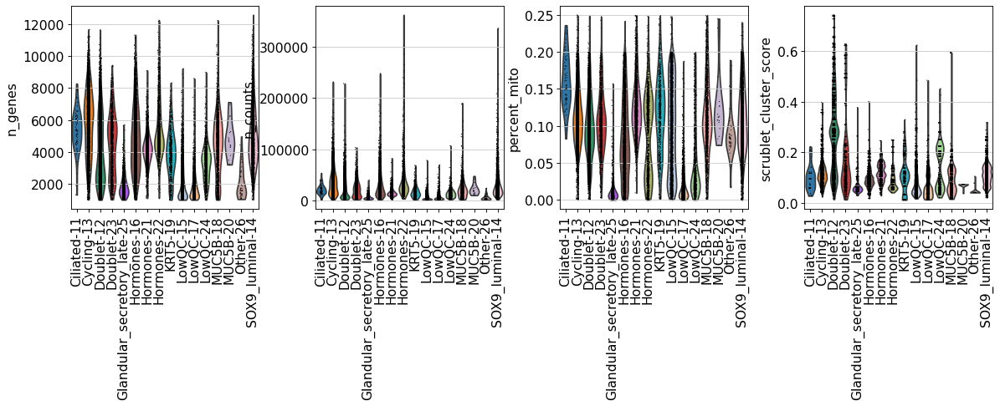

In [51]:
sc.pl.umap(adata, color=['Mareckova_epi_celltype', 'Mareckova_epi_lineage', 'GarciaAlonso_epi_celltype'], legend_loc='on data', legend_fontsize=6, ncols=1, save='_celltype.pdf')
sc.pl.umap(adata, color=['Mareckova_epi_celltype', 'Mareckova_epi_lineage', 'GarciaAlonso_epi_celltype'], legend_fontsize=6, ncols=1, save='_celltype_legend.pdf')

sc.pl.dotplot(adata, marker_genes, groupby='Mareckova_epi_celltype', standard_scale='var', save='MARKERS_celltype.pdf')
sc.pl.umap(adata, color=['n_genes','n_counts','scrublet_score', 'percent_mito'], color_map='OrRd')

adata.obs['leiden_celltype'] =  [a + '-' + b  for a, b in zip(adata.obs['leiden'], adata.obs['Mareckova_epi_celltype'])]
adata.obs['celltype_leiden'] =  [a + '-' + b  for b, a in zip(adata.obs['leiden'], adata.obs['Mareckova_epi_celltype'])]
sc.pl.dotplot(adata, marker_genes, groupby='celltype_leiden', standard_scale='var')
sc.pl.violin(adata[[ float(i) <= 10 for i in adata.obs.leiden ]], keys= ['n_genes', 'n_counts', 'percent_mito', 'scrublet_cluster_score'], groupby = 'celltype_leiden', rotation = 90)
sc.pl.violin(adata[[ float(i) > 10 for i in adata.obs.leiden ]], keys= ['n_genes', 'n_counts', 'percent_mito', 'scrublet_cluster_score'], groupby = 'celltype_leiden', rotation = 90)


In [52]:
# sc.pl.violin(adata, keys= ['n_genes', 'n_counts', 'percent_mito', 'scrublet_cluster_score'], groupby = 'celltype_leiden', rotation = 90)

In [53]:
# adata.write('x.h5ad')
pd.DataFrame(adata.obs).to_csv('/nfs/team292/lg18/endometriosis/annotations/cells_endometrium_epithelial.csv')

In [54]:
sampleID = [a + '-' + b + '-' + c + '-' + d for a, b, c, d in zip(adata.obs['dataset'], 
                                         adata.obs['Stage'], adata.obs['Group'],
                                                     adata.obs['genotype'])]

adata.obs['genotype_dataset'] = sampleID

sampleID = [a + '-' + b + '-' + c + '-' + d for a, b, c, d in zip(adata.obs['Stage'], 
                                                                  adata.obs['genotype'], 
                                                                  adata.obs['Treatment'],
                                                                  adata.obs['library'])]

adata.obs['donor_libary'] = sampleID


sampleID = [a + '-' + b  for a, b in zip(adata.obs['Binary Stage'], 
                                                     adata.obs['Group'])]

adata.obs['Group_stage'] = sampleID

/home/jovyan/my-conda-envs/sc_analysis/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)
/home/jovyan/my-conda-envs/sc_analysis/lib/python3.7/site-packages/ipykernel_launcher.py:16: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "optimize" which is no longer supported as of 3.3 and will become an error two minor releases later
  app.launch_new_instance()
/home/jovyan/my-conda-envs/sc_analysis/lib/python3.7/site-packages/ipykernel_launcher.py:16: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "optimize" which is no longer supported as of 3.3 and will become an error two minor releases later
  app.launch_new_instance()
/home/jovyan/my-conda-envs/sc_analysis/lib/python3.7/site-packages/ipykernel_launcher.py:16: MatplotlibDeprecationWarning: savefig() g

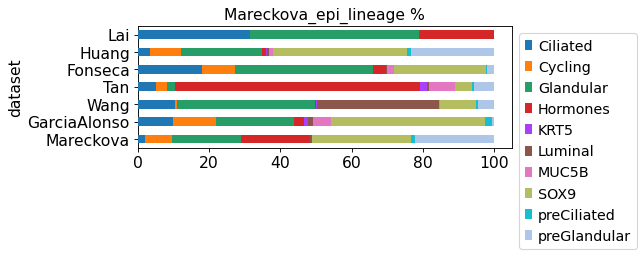

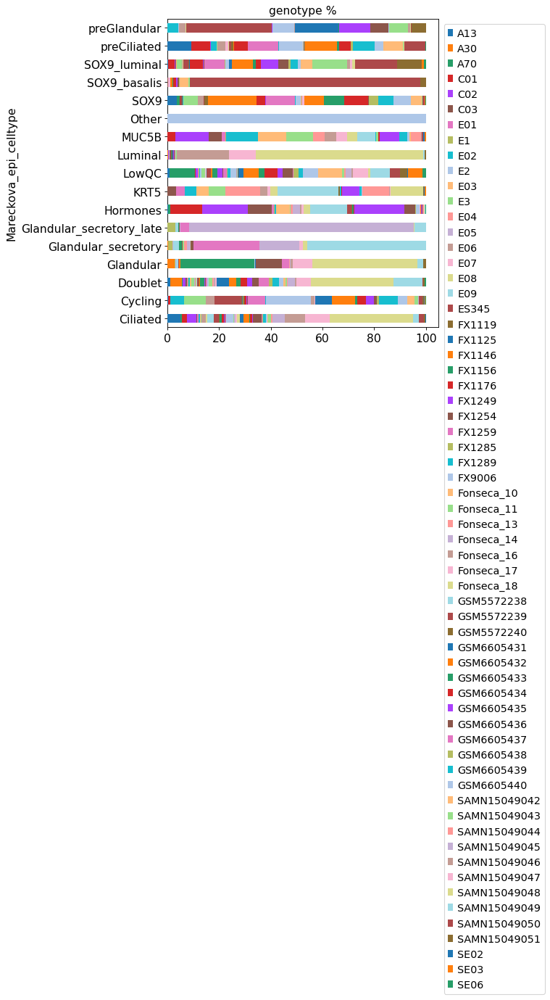

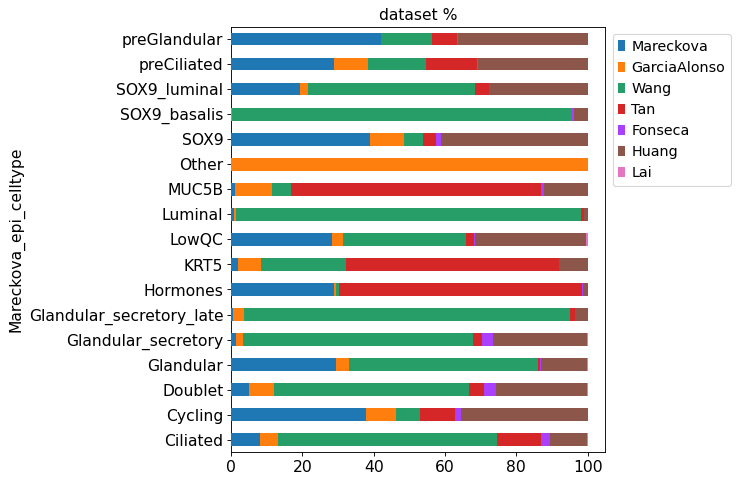

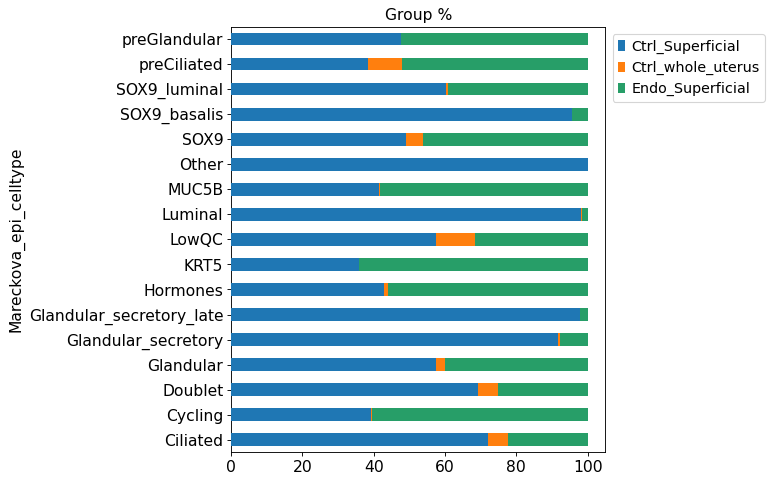

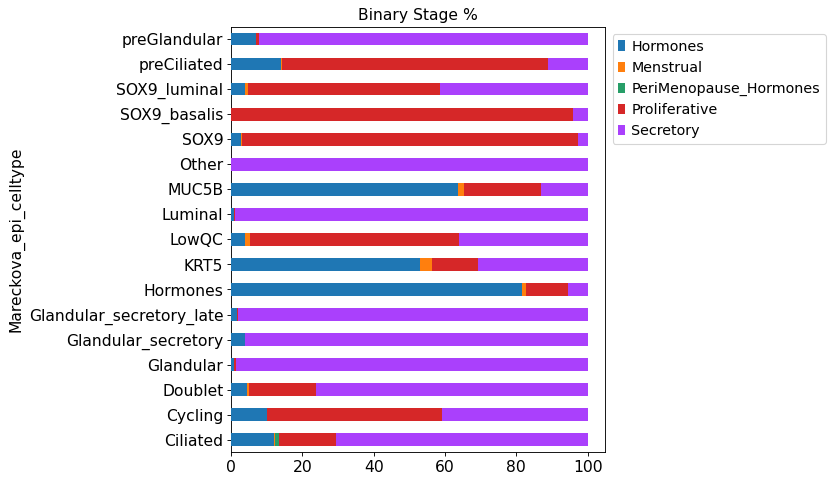

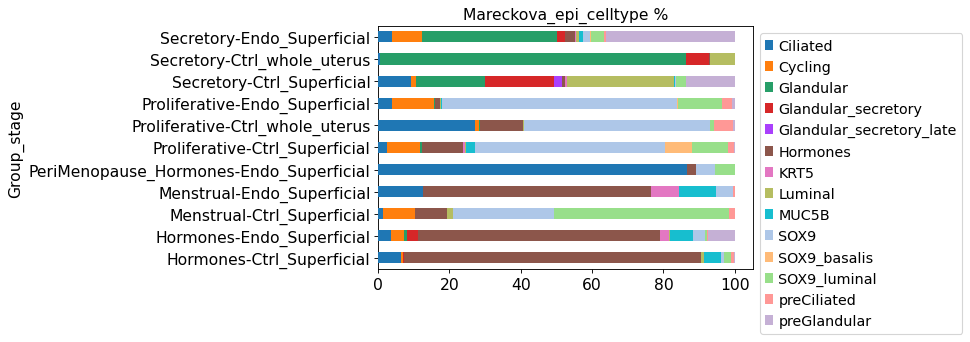

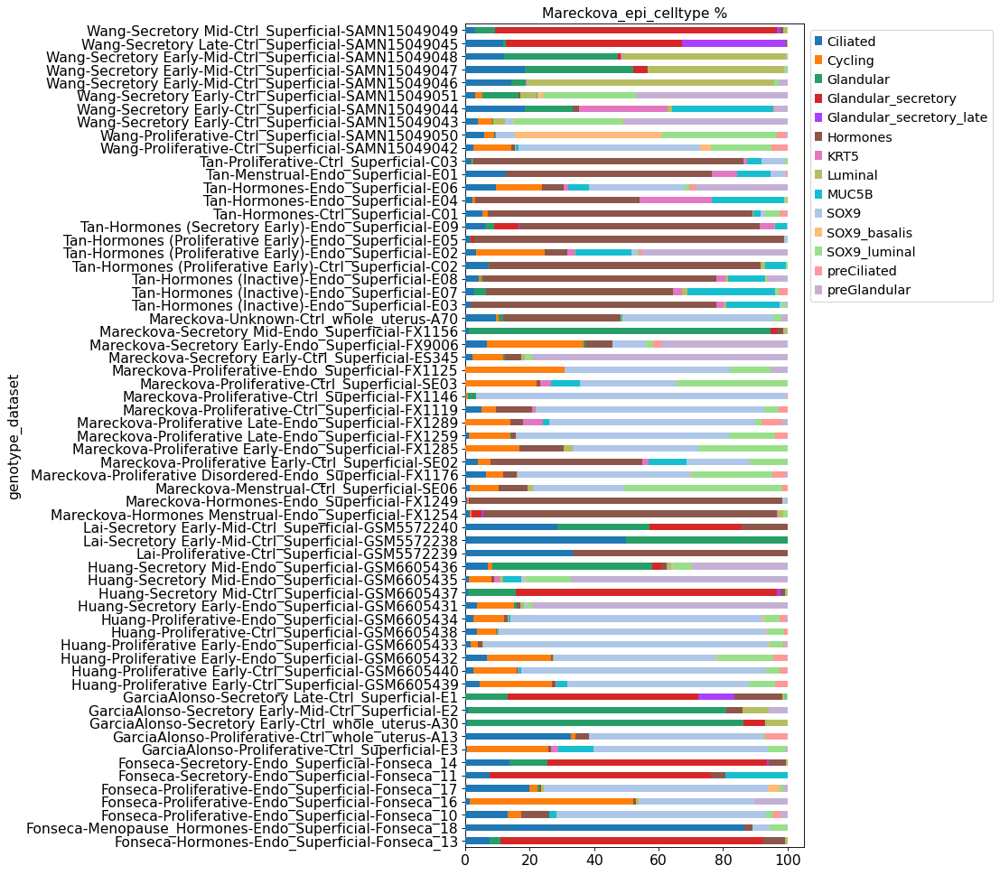

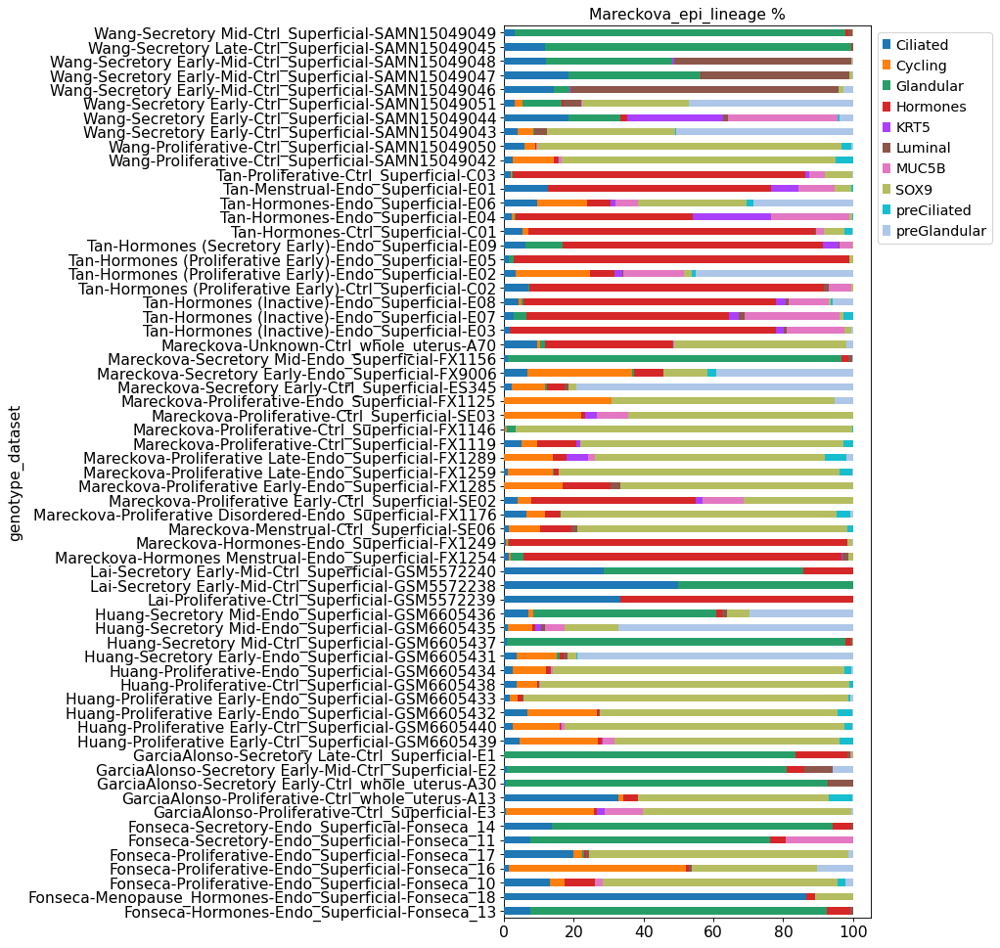

In [55]:
X = adata[[i not in ['Doublet', 'LowQC', 'Other'] for i in adata.obs.Mareckova_epi_celltype ]]
Barplot('Mareckova_epi_lineage', X, var='dataset', height=2)
Barplot('genotype', adata, var='Mareckova_epi_celltype', height=7)
Barplot('dataset', adata, var='Mareckova_epi_celltype', height=7)
Barplot('Group', adata, var='Mareckova_epi_celltype', height=7)
Barplot('Binary Stage', adata, var='Mareckova_epi_celltype', height=7)

Barplot('Mareckova_epi_celltype', X, var='Group_stage', height=4)
Barplot('Mareckova_epi_celltype', X, var='genotype_dataset', height=15)
Barplot('Mareckova_epi_lineage', X, var='genotype_dataset', height=15)

In [56]:
adata.obs['Mareckova_epi_celltype'].values.describe()

,counts,freqs
categories,,
Ciliated,6236,0.055199
Cycling,4542,0.040204
Doublet,7442,0.065874
Glandular,14418,0.127623
Glandular_secretory,8893,0.078718
Glandular_secretory_late,930,0.008232
Hormones,15028,0.133023
KRT5,539,0.004771
LowQC,8078,0.071504


# TF-IDF

In [57]:
import anndata
adataDown = adata[[ i in ["G1"] for i in adata.obs.phase ]]
sc.pp.filter_cells(adataDown, min_genes=2000)
sc.pp.filter_genes(adataDown, min_cells=5)
# print(adataDown.obs['leiden'].value_counts())

### Dowsample the whole dataset UN-EVEN
# adataDown = sc.pp.subsample(XX, fraction=0.25, random_state=0, copy=True) 


### Downsample to the smallest pop size
target_cells = 50

adataDown.obs['cell'] = adataDown.obs.index
adatas = [adataDown[adataDown.obs['leiden'].isin([cl])] for cl in adataDown.obs['leiden'].cat.categories]
# adatas = [adataDown[ adataDown.obs['leiden']==cl ] for cl in adataDown.obs['leiden'].cat.categories]

for dat in adatas:
    if dat.n_obs > target_cells:
        sc.pp.subsample(dat, n_obs=target_cells, random_state=0)
adata_downsampled = adatas[0].concatenate(*adatas[1:])
adataDown = adataDown[[ i in adata_downsampled.obs.cell.tolist() for i in adataDown.obs['cell'] ]]

sc.pp.filter_genes(adataDown, min_cells=10)
print(adataDown.obs['leiden'].value_counts())

del adata_downsampled
del adatas

/home/jovyan/my-conda-envs/sc_analysis/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)
filtered out 20975 cells that have less than 2000 genes expressed
Trying to set attribute `.obs` of view, copying.
filtered out 37 genes that are detected in less than 5 cells
filtered out 2755 genes that are detected in less than 10 cells
Trying to set attribute `.var` of view, copying.


0     50
1     50
25    50
24    50
23    50
22    50
21    50
19    50
18    50
17    50
16    50
15    50
14    50
13    50
12    50
9     50
8     50
7     50
6     50
5     50
4     50
3     50
2     50
10    28
11    20
20    18
26    15
Name: leiden, dtype: int64


In [58]:
import rpy2.rinterface_lib.callbacks
import logging
# Itoliste R warning messages
#Note: this can be commented out to get more verbose R output
rpy2.rinterface_lib.callbacks.logger.setLevel(logging.ERROR)
import anndata2ri
anndata2ri.activate()
%load_ext rpy2.ipython


The rpy2.ipython extension is already loaded. To reload it, use:
  %reload_ext rpy2.ipython


In [59]:
# This is just to allow moving adata to R without errors
adataDown.X = adataDown.X.toarray()

idx = ['n_genes', 'sample',  'percent_mito', 'n_counts', 'batch', 'S_score', 'G2M_score', 'phase', 
       'scrublet_score', 'scrublet_cluster_score', 'zscore', 'bh_pval', 'bonf_pval', 'is_doublet']
for i in idx:
    del adataDown.obs[i]
    
adataDown.obs['leiden'] = adataDown.obs['leiden'].astype(str)

del adataDown.obsm['X_scVI']
del adataDown.obsm['X_umap']
del adataDown.obsp['connectivities']
del adataDown.obsp['distances']
del adataDown.uns

In [60]:
%%R -i adataDown
adataDown

class: SingleCellExperiment 
dim: 14944 1231 
metadata(0):
assays(1): X
rownames(14944): A1BG A2M ... ZYX ZZEF1
rowData names(220): gene_ids.0.Fonseca feature_types.0.Fonseca ...
  highly_variable_nbatches n_cells
colnames(1231): HCA_A_RepT_RNA13247830_AACTGGTCAGCTGCTG-Mareckova
  HCA_A_RepT_RNA13247830_ACAGCCGCACGGCTAC-Mareckova ...
  GSM5572239_TCTGCCATCACAAGAA-Lai GSM5572240_TGGTACACAAGTATAG-Lai
colData names(64): library StudyName ... Group_stage cell
reducedDimNames(0):
altExpNames(0):


### By Leiden

In [61]:
%%R -o df_tfIDF -o topgenes_tfIDF

library(Seurat)
library(SoupX)
library(dplyr)
seurat_andata = as.Seurat(adataDown, counts = "X", data = "X")
Idents(seurat_andata) = seurat_andata$celltype_leiden


df_tfIDF = quickMarkers(toc = seurat_andata@assays$RNA@counts, clusters = Idents(seurat_andata), N = 500)

df_tfIDF$cluster = factor(df_tfIDF$cluster, levels = unique(sort(df_tfIDF$cluster))  )
topgenes_tfIDF = subset(df_tfIDF, qval <= 0.05) %>%
  group_by(cluster) %>%
  group_map(~ head(.x, 20L)$gene)
names(topgenes_tfIDF) = paste('cl', levels(df_tfIDF$cluster) )

In [62]:
df_tfIDF.to_csv('TFIDF_leiden.tsv', index=False, sep='\t')

... storing 'genotype_dataset' as categorical
... storing 'donor_libary' as categorical
... storing 'Group_stage' as categorical


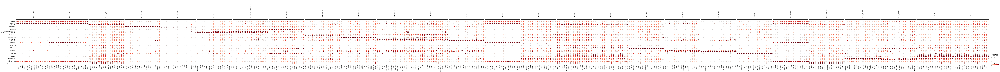

In [63]:
topgenes_tfIDF = dict(zip(topgenes_tfIDF.names, map(list,list(topgenes_tfIDF)))) # this is to convert into a dictionary for plotting
for i in topgenes_tfIDF.keys():
    topgenes_tfIDF[i] = [value for value in topgenes_tfIDF[i] if value in adata.var_names] 
    

    
sc.pl.dotplot(adata, topgenes_tfIDF, groupby='celltype_leiden', standard_scale = 'var', save='TFIDF_leiden.pdf')#topgenes_tfIDF

## By celltype

In [64]:
import anndata
adataDown = adata[[ i not in ['Doublet','Other', 'LowQC'] for i in adata.obs.Mareckova_epi_celltype ]]
sc.pp.filter_cells(adataDown, min_genes=2000)
sc.pp.filter_genes(adataDown, min_cells=5)
# print(adataDown.obs['leiden'].value_counts())

### Dowsample the whole dataset UN-EVEN
# adataDown = sc.pp.subsample(XX, fraction=0.25, random_state=0, copy=True) 


### Downsample to the smallest pop size
target_cells = 50

adataDown.obs['cell'] = adataDown.obs.index
adatas = [adataDown[adataDown.obs['Mareckova_epi_celltype'].isin([cl])] for cl in adataDown.obs['Mareckova_epi_celltype'].cat.categories]
# adatas = [adataDown[ adataDown.obs['leiden']==cl ] for cl in adataDown.obs['leiden'].cat.categories]

for dat in adatas:
    if dat.n_obs > target_cells:
        sc.pp.subsample(dat, n_obs=target_cells, random_state=0)
adata_downsampled = adatas[0].concatenate(*adatas[1:])
adataDown = adataDown[[ i in adata_downsampled.obs.cell.tolist() for i in adataDown.obs['cell'] ]]

sc.pp.filter_genes(adataDown, min_cells=10)
print(adataDown.obs['Mareckova_epi_celltype'].value_counts())

del adata_downsampled
del adatas

/home/jovyan/my-conda-envs/sc_analysis/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)
filtered out 15834 cells that have less than 2000 genes expressed
Trying to set attribute `.obs` of view, copying.
filtered out 72 genes that are detected in less than 5 cells
filtered out 3527 genes that are detected in less than 10 cells
Trying to set attribute `.var` of view, copying.


Ciliated                    50
Cycling                     50
Glandular                   50
Glandular_secretory         50
Glandular_secretory_late    50
Hormones                    50
KRT5                        50
Luminal                     50
MUC5B                       50
SOX9                        50
SOX9_basalis                50
SOX9_luminal                50
preCiliated                 50
preGlandular                50
Name: Mareckova_epi_celltype, dtype: int64


In [65]:
# This is just to allow moving adata to R without errors
adataDown.X = adataDown.X.toarray()

idx = ['n_genes', 'sample',  'percent_mito', 'n_counts', 'batch', 'S_score', 'G2M_score', 'phase', 
       'scrublet_score', 'scrublet_cluster_score', 'zscore', 'bh_pval', 'bonf_pval', 'is_doublet']
for i in idx:
    del adataDown.obs[i]
    
adataDown.obs['leiden'] = adataDown.obs['leiden'].astype(str)

del adataDown.obsm['X_scVI']
del adataDown.obsm['X_umap']
del adataDown.obsp['connectivities']
del adataDown.obsp['distances']
del adataDown.uns

In [66]:
%%R -i adataDown
adataDown

class: SingleCellExperiment 
dim: 14137 700 
metadata(0):
assays(1): X
rownames(14137): A1BG A2M ... ZYX ZZEF1
rowData names(220): gene_ids.0.Fonseca feature_types.0.Fonseca ...
  highly_variable_nbatches n_cells
colnames(700): UA_Endo9426399_CGGGTGTTCCGAAGGA-Mareckova
  UA_Endo9426400_ACCTACCCAACTGAAA-Mareckova ...
  GSM6605436_TGTTTGTTCTCTCGCA-Huang GSM6605436_TTTCACACAGACAAGC-Huang
colData names(64): library StudyName ... Group_stage cell
reducedDimNames(0):
altExpNames(0):


In [67]:
%%R -o df_tfIDF -o topgenes_tfIDF

library(Seurat)
library(SoupX)
library(dplyr)
seurat_andata = as.Seurat(adataDown, counts = "X", data = "X")
Idents(seurat_andata) = seurat_andata$Mareckova_epi_celltype


df_tfIDF = quickMarkers(toc = seurat_andata@assays$RNA@counts, clusters = Idents(seurat_andata), N = 500)

df_tfIDF$cluster = factor(df_tfIDF$cluster, levels = unique(df_tfIDF$cluster)  )
topgenes_tfIDF = subset(df_tfIDF, qval <= 1) %>%
  group_by(cluster) %>%
  group_map(~ head(.x, 30L)$gene)
names(topgenes_tfIDF) = unique(df_tfIDF$cluster)

In [68]:
df_tfIDF.to_csv('TFIDF_allcells_Mareckova_epi_celltype.tsv', index=False, sep='\t')

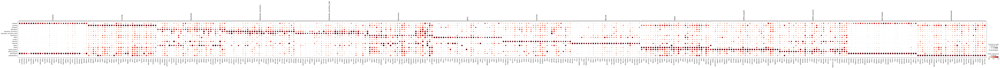

In [69]:
topgenes_tfIDF = dict(zip(topgenes_tfIDF.names, map(list,list(topgenes_tfIDF)))) # this is to convert into a dictionary for plotting
for i in topgenes_tfIDF.keys():
    topgenes_tfIDF[i] = [value for value in topgenes_tfIDF[i] if value in adata.var_names] 
    

    
sc.pl.dotplot(adata, topgenes_tfIDF, groupby='Mareckova_epi_celltype', standard_scale = 'var', save='TFIDF_epithelial_Mareckova_epi_celltype.pdf')#topgenes_tfIDF

In [70]:
res = pd.DataFrame(columns=adata.var_names, index=adata.obs['Mareckova_epi_celltype'].cat.categories)                                                                                                 

for clust in adata.obs.Mareckova_epi_celltype.cat.categories: 
    res.loc[clust] = adata[adata.obs['Mareckova_epi_celltype'].isin([clust]),:].obs.n_counts.mean(0)

res

/home/jovyan/my-conda-envs/sc_analysis/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


,A1BG,A2M,A4GALT,AAAS,AACS,AADAC,AADACL2,AADACL4,AADAT,AAGAB,...,ZSWIM9,ZW10,ZWILCH,ZXDA,ZXDB,ZXDC,ZYG11A,ZYG11B,ZYX,ZZEF1
Ciliated,16160.728516,16160.728516,16160.728516,16160.728516,16160.728516,16160.728516,16160.728516,16160.728516,16160.728516,16160.728516,...,16160.728516,16160.728516,16160.728516,16160.728516,16160.728516,16160.728516,16160.728516,16160.728516,16160.728516,16160.728516
Cycling,35628.78125,35628.78125,35628.78125,35628.78125,35628.78125,35628.78125,35628.78125,35628.78125,35628.78125,35628.78125,...,35628.78125,35628.78125,35628.78125,35628.78125,35628.78125,35628.78125,35628.78125,35628.78125,35628.78125,35628.78125
Doublet,20018.369141,20018.369141,20018.369141,20018.369141,20018.369141,20018.369141,20018.369141,20018.369141,20018.369141,20018.369141,...,20018.369141,20018.369141,20018.369141,20018.369141,20018.369141,20018.369141,20018.369141,20018.369141,20018.369141,20018.369141
Glandular,12557.630859,12557.630859,12557.630859,12557.630859,12557.630859,12557.630859,12557.630859,12557.630859,12557.630859,12557.630859,...,12557.630859,12557.630859,12557.630859,12557.630859,12557.630859,12557.630859,12557.630859,12557.630859,12557.630859,12557.630859
Glandular_secretory,20663.726562,20663.726562,20663.726562,20663.726562,20663.726562,20663.726562,20663.726562,20663.726562,20663.726562,20663.726562,...,20663.726562,20663.726562,20663.726562,20663.726562,20663.726562,20663.726562,20663.726562,20663.726562,20663.726562,20663.726562
Glandular_secretory_late,6021.666504,6021.666504,6021.666504,6021.666504,6021.666504,6021.666504,6021.666504,6021.666504,6021.666504,6021.666504,...,6021.666504,6021.666504,6021.666504,6021.666504,6021.666504,6021.666504,6021.666504,6021.666504,6021.666504,6021.666504
Hormones,22525.167969,22525.167969,22525.167969,22525.167969,22525.167969,22525.167969,22525.167969,22525.167969,22525.167969,22525.167969,...,22525.167969,22525.167969,22525.167969,22525.167969,22525.167969,22525.167969,22525.167969,22525.167969,22525.167969,22525.167969
KRT5,16720.355469,16720.355469,16720.355469,16720.355469,16720.355469,16720.355469,16720.355469,16720.355469,16720.355469,16720.355469,...,16720.355469,16720.355469,16720.355469,16720.355469,16720.355469,16720.355469,16720.355469,16720.355469,16720.355469,16720.355469
LowQC,6272.64209,6272.64209,6272.64209,6272.64209,6272.64209,6272.64209,6272.64209,6272.64209,6272.64209,6272.64209,...,6272.64209,6272.64209,6272.64209,6272.64209,6272.64209,6272.64209,6272.64209,6272.64209,6272.64209,6272.64209
Luminal,10176.549805,10176.549805,10176.549805,10176.549805,10176.549805,10176.549805,10176.549805,10176.549805,10176.549805,10176.549805,...,10176.549805,10176.549805,10176.549805,10176.549805,10176.549805,10176.549805,10176.549805,10176.549805,10176.549805,10176.549805


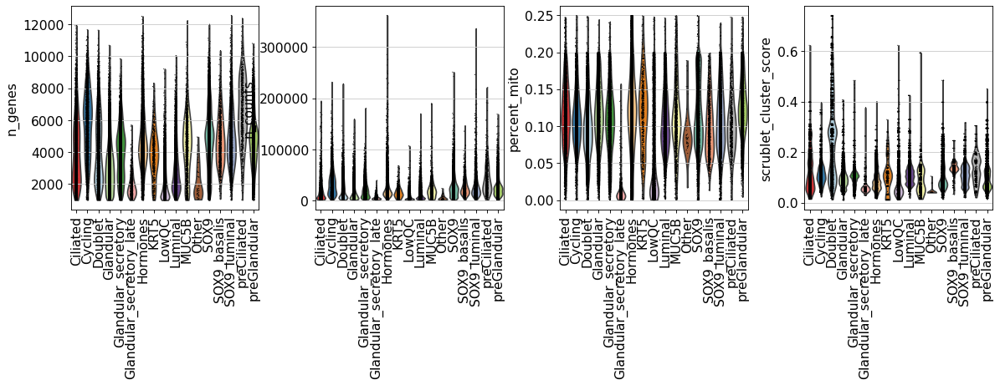

In [71]:
sc.pl.violin(adata, keys= ['n_genes', 'n_counts', 'percent_mito', 'scrublet_cluster_score'], groupby = 'Mareckova_epi_celltype', rotation = 90)

In [72]:
pd.crosstab(adata.obs.genotype_dataset, adata.obs.Mareckova_epi_celltype )

Mareckova_epi_celltype,Ciliated,Cycling,Doublet,Glandular,Glandular_secretory,Glandular_secretory_late,Hormones,KRT5,LowQC,Luminal,MUC5B,Other,SOX9,SOX9_basalis,SOX9_luminal,preCiliated,preGlandular
genotype_dataset,,,,,,,,,,,,,,,,,
Fonseca-Hormones-Endo_Superficial-Fonseca_13,9,0,45,4,98,0,8,0,2,1,0,0,0,0,0,0,0
Fonseca-Menopause_Hormones-Endo_Superficial-Fonseca_18,64,0,0,0,0,0,2,0,3,0,0,0,4,0,4,0,0
Fonseca-Proliferative-Endo_Superficial-Fonseca_10,6,2,0,0,0,0,4,0,0,0,1,0,30,0,1,1,1
Fonseca-Proliferative-Endo_Superficial-Fonseca_16,2,69,14,0,0,0,1,0,20,1,0,0,49,0,0,0,14
Fonseca-Proliferative-Endo_Superficial-Fonseca_17,33,4,49,1,0,0,1,0,5,1,0,0,115,6,2,0,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Wang-Secretory Early-Mid-Ctrl_Superficial-SAMN15049046,487,1,43,152,0,0,5,2,52,2636,1,0,1,0,49,0,89
Wang-Secretory Early-Mid-Ctrl_Superficial-SAMN15049047,593,0,402,1073,135,0,8,1,467,1345,2,0,0,0,30,0,4
Wang-Secretory Early-Mid-Ctrl_Superficial-SAMN15049048,2024,2,2388,5883,127,2,23,69,68,8446,1,0,0,0,54,1,49


In [73]:
adata.write('/nfs/team292/lg18/endometriosis/clustered_objects/cells_epithelial.h5ad')